## Goal
We are trying to create a genre classifier with an accuracy of at least 75% for Blues, Country, Electronic, Folk, Jazz, Latin, Rap, and Rock music. 


## Approaches
- Create tensors with music data from .h5 files in our assembled dataset. Then, we can train an image classifier on them, with the genre of each tensor as the ground truth label.
- If the approach outlined above doesn't work (This may be the case if samples from different genres are not different enough from each other), get access to the audio clips corresponding to each sample. Here, we have two options:
    1. run image classification on tensors made from the audio.
    2. Analyze the audio using the librosa python library to produce more features in addition to the one provided by the MSD. Then, we could go through the first outlined approach, but with more features for each sample. 

If our assembled dataset doesn't have enough samples for one or more genres, we could try using our Google Cloud credits to download the entire MSD, and repeat our data assembling process on that. 

## Options for ML Models
- VGG-19



# Imports

In [1]:
# hdf5 file getter functions
# https://github.com/tbertinmahieux/MSongsDB/blob/master/PythonSrc/hdf5_getters.py
# ^ Link above has all the getters (Which also tells us all of the different attributes)

!wget https://raw.githubusercontent.com/tbertinmahieux/MSongsDB/master/PythonSrc/hdf5_getters.py
!pip install tables # need PyTables package to use hdf5_getters

# For getting dataset from google drive
!pip install googledrivedownloader

# For searching youtube for music
!pip install youtube-search-python

# For downloading music from youtube
!pip install youtube_dl

# For splitting music files from youtube into equal-sized chunks 
!pip install pydub

# A framework for creating an ensemble of classifiers
!pip install torchensemble

--2021-05-16 02:27:13--  https://raw.githubusercontent.com/tbertinmahieux/MSongsDB/master/PythonSrc/hdf5_getters.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 21702 (21K) [text/plain]
Saving to: ‘hdf5_getters.py’

hdf5_getters.py     100%[===================>]  21.19K  --.-KB/s    in 0s      

2021-05-16 02:27:13 (92.8 MB/s) - ‘hdf5_getters.py’ saved [21702/21702]

     |████████████████████████████████| 71kB 9.6MB/s 
     |████████████████████████████████| 81kB 10.3MB/s 
     |████████████████████████████████| 61kB 9.2MB/s 
     |████████████████████████████████| 61kB 9.4MB/s 
     |████████████████████████████████| 1.9MB 32.7MB/s 
     |████████████████████████████████| 22.3MB 1.9MB/s 
  Found existing installation: scikit-learn 0.22.2.post1
    Unins

In [2]:
#imports

import tables
import hdf5_getters
# check for bug in hdf5_getters.py: line 39: tables.openFile(h5filename, mode='r') should be tables.open_file(h5filename, mode='r')
import os
import torch, torchvision
from torch import nn, optim
from torchvision import datasets, models, transforms
from torch.utils.data import Dataset
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from google_drive_downloader import GoogleDriveDownloader as gdd
from torch.autograd import Variable
import numpy as np
from youtubesearchpython import VideosSearch
import pickle
import youtube_dl
import librosa
import librosa.display
import IPython.display as ipd
import wave # to find the duration of a song
from pydub import AudioSegment
import urllib.error
import time
# PyTorch Ensemble: A framework for creating classifier ensembles 
from torchensemble.utils.logging import set_logger
from torchensemble import VotingClassifier


# The Model

In [3]:
# model class
class GenreClassifier(nn.Module):
  def __init__(self):
        super(GenreClassifier, self).__init__()
        # download the pretrained vgg-19 from torchvision 
        self.vgg = torchvision.models.vgg19(pretrained=True)
        # give the output layer 8 output features
        self.vgg.classifier[-1] = nn.Linear(in_features=4096, out_features=8, bias=True)
        print(self.vgg)

  def forward (self, X):
    output = self.vgg(X)
    return output

In [4]:
# making the ensemble
model = VotingClassifier(
    estimator=GenreClassifier,
    n_estimators=7,
    cuda=True
)

In [5]:
# set the optimizer
model.set_optimizer("SGD",              # optimizer name
                    lr=1e-3,            # learning rate of the optimizer
                    momentum=0.7)       # weight decay of the optimizer

In [6]:
# set scheduler
model.set_scheduler("StepLR",
              step_size=5, 
              gamma=0.15)

In [7]:
# Set the Logger
logger = set_logger("genre_classifier_log")

Log will be saved in '/content/logs'.
Create folder 'logs/'
Start logging into file /content/logs/genre_classifier_log-2021_05_16_02_27.log...


#M2: Preparing the Million Song Subset Data and Dataset

Need to define a custom PyTorch dataset class to accomplish this. This class should:
- inherit torch.utils.data.Dataset 
- override \_\_len__ to enable len(...) to give the number of samples in the dataset. 
- override \_\_getitem__ to enable indexing so that dataset[i] gives the i^th sample in the dataset.
  - Let each sample follow the format: 
    - torch.LongTensor(genre_label, sample_data_appended_together)
  - Will use hdf5_getters.py to read data from .h5 files.

#### Prerequisites
- Need to gather together all the .h5 files in a convenient way to feed into genreClassificationDataset. (method outlined below)
  - get **all** the desired .h5 files from the Million Song Subset and put them in directories "data/\<genre>" (reorganize the github repo to reflect this). To gather all the desired .h5 files, we can 
    - drag-and-drop these files from your computer into corresponding directories in Google Colab's virtual machine, or 
    - transfer the root directory "data" to Google Drive and download from there, or 
    - find a way to download the root directory from Github.
  - We chose to use Google Drive.  
  
- Need to find a way to organize the .h5 files so that a file's genre is apparent from either its name or its path. (method outlined below)
  - keep .h5 files in directory "data/\<genre>". The root directory, "data," wil be an argument to be passed to genreClassificationDataset(...) when creating a new dataset.

## Features that we can extract (Ones marked "Yes" are to be used in the final model)

    analysis_sample_rate = tables.IntCol()
    audio_md5 = tables.StringCol(32)
    danceability = tables.Float64Col()
    duration = tables.Float64Col()
    end_of_fade_in = tables.Float64Col()
    energy = tables.Float64Col()
    key = tables.IntCol()                    [Yes]
    key_confidence = tables.Float64Col()
    loudness = tables.Float64Col()           
    mode = tables.IntCol()                   [Yes] 
    mode_confidence = tables.Float64Col()
    start_of_fade_out = tables.Float64Col()
    tempo = tables.Float64Col()              [Yes]
    time_signature = tables.IntCol()
    time_signature_confidence = tables.Float64Col()
    track_id = tables.StringCol(32)
    # ARRAY INDICES
    idx_segments_start = tables.IntCol()
    idx_segments_confidence = tables.IntCol()
    idx_segments_pitches = tables.IntCol()
    idx_segments_timbre = tables.IntCol()
    idx_segments_loudness_max = tables.IntCol()
    idx_segments_loudness_max_time = tables.IntCol()
    idx_segments_loudness_start = tables.IntCol()
    idx_sections_start = tables.IntCol()
    idx_sections_confidence = tables.IntCol()
    idx_beats_start = tables.IntCol()
    idx_beats_confidence = tables.IntCol()
    idx_bars_start = tables.IntCol()
    idx_bars_confidence = tables.IntCol()
    idx_tatums_start = tables.IntCol()
    idx_tatums_confidence = tables.IntCol()
    

    artist_name = tables.StringCol(MAXSTRLEN)
    artist_id = tables.StringCol(32)
    artist_mbid = tables.StringCol(40)
    artist_playmeid = tables.IntCol()
    artist_7digitalid = tables.IntCol()
    analyzer_version = tables.StringCol(32)
    genre = tables.StringCol(MAXSTRLEN)
    release = tables.StringCol(MAXSTRLEN)
    release_7digitalid = tables.IntCol()
    title = tables.StringCol(MAXSTRLEN)
    artist_familiarity = tables.Float64Col()
    artist_hotttnesss = tables.Float64Col()
    song_id = tables.StringCol(32)
    song_hotttnesss = tables.Float64Col()
    artist_latitude = tables.Float64Col()
    artist_longitude = tables.Float64Col()
    artist_location = tables.StringCol(MAXSTRLEN)
    track_7digitalid = tables.IntCol()
    # ARRAY INDICES
    idx_similar_artists = tables.IntCol()        [Yes]
    idx_artist_terms = tables.IntCol()

## Finding the Desired Shape of the VGG19 Model's Input

In [ ]:
# learning to work with os.fsencode and os.fsdecode. These will help iterate through files in genre directories.

#rock_folder = os.fsencode(os.path.join("data", "Rock"))
#for file in os.listdir(rock_folder)[:10]:
#  print(os.fsdecode(file))
#  print(type(file))
#  print(type(os.fsdecode(file)))


In [ ]:
# type(os.fsdecode(os.listdir(rock_folder)[0]))

In [ ]:
#len(os.listdir(rock_folder))

In [ ]:
#min([1,2,3,-100,4,5])

In [ ]:
# # What should the shape of our model inputs be? Let's find out by passing tensors of 
# # different shapes through a dummy Conv2d layer with same parameters as first layer 
# # of VGG19

# test_conv_layer = nn.Conv2d(3, 64, kernel_size=(3,3), stride=(1,1), padding=(1,1))

# print(test_conv_layer)
# print(test_conv_layer.weight.size())

# input_shape = (1, 3, 3691, 12)
# test_conv_layer_output = test_conv_layer.forward(torch.ones(input_shape))
# print(f"\nModel input's shape: {torch.ones(input_shape).size()}")
# print(test_conv_layer_output)
# print(f"First layer output's shape: {test_conv_layer_output.size()}")


# # The second number in the input_shape tuple corresponds to number of channels.
# # If the model's input were an image, then the last two number in the input_shape 
# # tuple would correspond to the width and height of the image.

# # So really, the shape of our input should be (1, 3, x, y), with x and y being 
# # whatever we need them to be (I checked diff. comboes of input shapes, and the only 
# # thing that caused an error, was if I changed the second element input_shape from 
# # 3 into anything else).  

Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
torch.Size([64, 3, 3, 3])

Model input's shape: torch.Size([1, 3, 3691, 12])
tensor([[[[-0.3878,  0.1665,  0.1665,  ...,  0.1665,  0.1665,  0.4815],
          [-0.2012,  0.3151,  0.3151,  ...,  0.3151,  0.3151,  0.4563],
          [-0.2012,  0.3151,  0.3151,  ...,  0.3151,  0.3151,  0.4563],
          ...,
          [-0.2012,  0.3151,  0.3151,  ...,  0.3151,  0.3151,  0.4563],
          [-0.2012,  0.3151,  0.3151,  ...,  0.3151,  0.3151,  0.4563],
          [ 0.3275,  0.5361,  0.5361,  ...,  0.5361,  0.5361,  0.3371]],

         [[-0.2637, -0.3180, -0.3180,  ..., -0.3180, -0.3180, -0.0934],
          [-0.3885, -0.2400, -0.2400,  ..., -0.2400, -0.2400,  0.2181],
          [-0.3885, -0.2400, -0.2400,  ..., -0.2400, -0.2400,  0.2181],
          ...,
          [-0.3885, -0.2400, -0.2400,  ..., -0.2400, -0.2400,  0.2181],
          [-0.3885, -0.2400, -0.2400,  ..., -0.2400, -0.2400,  0.2181],
          [-0.2079,  0.0121,  0.01

## Getting the Dataset

In [ ]:
# # Creating separate directories
# %mkdir -p data/Jazz
# %mkdir -p data/Rock
# %mkdir -p data/Rap
# %mkdir -p data/Country
# %mkdir -p data/Blues
# %mkdir -p data/Folk
# %mkdir -p data/Latin
# %mkdir -p data/Electronic


In [ ]:
# # Country
# gdd.download_file_from_google_drive(file_id='1ZBz1AVQlno9LzowrDcrkNqnlxoeuu9Hh',
#                                     dest_path='./data/Country/Country.zip',
#                                     unzip=True)

# # Electronic
# gdd.download_file_from_google_drive(file_id='1z4lOR8S848C9jX-8_8NAnDXcOL8vanU7',
#                                     dest_path='./data/Electronic/Electronic.zip',
#                                     unzip=True)
# # Rock
# gdd.download_file_from_google_drive(file_id='1wzZAtco1Fne1ghId2aqY3JOD17EXX_cw',
#                                     dest_path='./data/Rock/Rock.zip',
#                                     unzip=True)
# # Rap
# gdd.download_file_from_google_drive(file_id='1bANWlBT-aS0ofEUhg1YB0NSe-22ljXPZ',
#                                     dest_path='./data/Rap/Rap.zip',
#                                     unzip=True)

# # Latin
# gdd.download_file_from_google_drive(file_id='1zUV-jZ8W8z0Pt74OeE8a50X-eguWHB7c',
#                                     dest_path='./data/Latin/Latin.zip',
#                                     unzip=True)

# # Jazz
# gdd.download_file_from_google_drive(file_id='1WoYPVm9_hnLkZekEh9JZYJfI6tXWlp9s',
#                                     dest_path='./data/Jazz/Jazz.zip',
#                                     unzip=True)

# # Folk
# gdd.download_file_from_google_drive(file_id='1gQeJ0xjALXkMfCTj8IgaczuFhwr1d962',
#                                     dest_path='./data/Folk/Folk.zip',
#                                     unzip=True)
# # Blues
# gdd.download_file_from_google_drive(file_id='1gQQf591gQ6bMY_4dyWNrhcinZ1VgLtv3',
#                                     dest_path='./data/Blues/Blues.zip',
#                                     unzip=True)

Unzipping...Done.
Unzipping...Done.
Unzipping...Done.
Unzipping...Done.
Unzipping...Done.
Unzipping...Done.
Unzipping...Done.
Unzipping...Done.


In [ ]:
# # removing the zip files from each genre directory

# !rm data/Blues/Blues.zip
# !rm data/Country/Country.zip
# !rm data/Electronic/Electronic.zip
# !rm data/Folk/Folk.zip
# !rm data/Jazz/Jazz.zip
# !rm data/Latin/Latin.zip
# !rm data/Rap/Rap.zip
# !rm data/Rock/Rock.zip

In [ ]:
# # print the number of files in each genre directory
# directories = ["data/Blues","data/Country","data/Electronic","data/Folk","data/Jazz","data/Latin","data/Rap","data/Rock"]
# counts = [0,0,0,0,0,0,0,0]
# for i in range(len(directories)):
#   dir = os.fsencode(directories[i])
#   for file in os.listdir(dir):
#     counts[i] += 1
# count_dict = dict(zip(directories, counts))
# print(count_dict)

{'data/Blues': 126, 'data/Country': 175, 'data/Electronic': 228, 'data/Folk': 48, 'data/Jazz': 99, 'data/Latin': 257, 'data/Rap': 236, 'data/Rock': 1265}


In [ ]:
# # There are only 48 "Folk" samples, which limits the number of samples that can be used for other genres to 48 as well. Remove/replace folk to use more data. 
# # Can also try removing the four worst represented genres, Folk, Jazz, Blues, and Country
# genres_dir_names = [ "Rock", "Rap", "Latin", "Electronic","Folk", "Jazz", "Blues", "Country"]     
# genres_dir_names

['Rock', 'Rap', 'Latin', 'Electronic', 'Folk', 'Jazz', 'Blues', 'Country']

## Creating a Custom Dataset Class

In [ ]:
#len(genres_dir_names)

8

In [ ]:
#genre_dict = dict(zip(genres_dir_names, range(len(genres_dir_names)))) 

In [ ]:
# genre_dict

{'Blues': 6,
 'Country': 7,
 'Electronic': 3,
 'Folk': 4,
 'Jazz': 5,
 'Latin': 2,
 'Rap': 1,
 'Rock': 0}

In [ ]:
# class genreClassificationDataset (Dataset):
#   def __init__ (self, root_dir, genre_dir_names):  
#     # create an iterable representation for each genre directory
#     # CITATION: https://stackoverflow.com/questions/10377998/how-can-i-iterate-over-files-in-a-given-directory
#     genre_dirs = []
#     for name in genre_dir_names: 
#       genre_dirs.append(os.fsencode(os.path.join(root_dir, name)))
    
#     # a dicionary to encode genres as integers
#     genre_dict = dict(zip(genre_dirs, range(len(genre_dirs))))
#     print(f"Genre encodings:\n{genre_dict}")
    
#     # get the number of elements in the directory with least elements
#     min_genre_samples = min( [len(os.listdir(genre_dirs[i])) for i in range(len(genre_dirs))] )

#     # the i^th element of genre_labels will be the label for the sample corresponding to sample_path[i]
#     self.genre_label = []
#     self.sample_path = [] # need path ins
#     for dir in genre_dirs: 
#       for file in os.listdir(dir)[:min_genre_samples]: # collect an equal number of samples for each genre
#         self.genre_label.append(genre_dict[dir])
#         dir_name = os.fsdecode(dir)
#         filename = os.fsdecode(file)
#         self.sample_path.append(os.path.join(dir_name,filename))

#     # finding the maximum dimension sizes among the samples for our features
#     self.st_max_size_dims = [0,0]           # Append a 0 to the max. dim. size array for every dimension of the segments_timbre arrays.
#                                             # Can find the data type and number of dimensions for every feature here: http://millionsongdataset.com/faq/
#                                             # First element of the st_max_size_dims array is the max size for the first dimension of segments_timbres, and so on.
    
#     self.max_loudness_max_size_dims = 0     # the max size for the max_loudness feature among all the samples in the dataset 
    
#     for x in self.sample_path:    
#       h5 = tables.open_file(x, mode='r')
#       segments_timbre = hdf5_getters.get_segments_timbre(h5)
#       max_loudness = hdf5_getters.get_segments_loudness_max(h5)
#       h5.close()

#       for i in range(len(self.st_max_size_dims)):                   # finding the max dimensions for the segments_timbre feature
#         if segments_timbre.shape[i] > self.st_max_size_dims[i]:
#           self.st_max_size_dims[i] = segments_timbre.shape[i]
      
#       if max_loudness.shape[0] > self.max_loudness_max_size_dims:   # finding the max dimensions for the max_loudness feature
#         self.max_loudness_max_size_dims = max_loudness.shape[0]

#     # print(self.st_max_size_dims) # checking if the code to build self.st_max_size_dims works
#     # print(self.max_loudness_max_size_dims) # checking if the code to build self.max_loudness_max_size_dims works
    
#     # pad and resize each element to the shape [3, 224, 224], then store.
#     self.samples = []
#     for x in self.sample_path:
#       h5 = tables.open_file(x, mode='r')
#       # extract the features
#       segments_timbre = hdf5_getters.get_segments_timbre(h5)
#       max_loudness = hdf5_getters.get_segments_loudness_max(h5)
#       h5.close()
#       # convert the features into a tensor
#       segments_timbre = torch.tensor(segments_timbre)
#       max_loudness = torch.tensor(max_loudness)
#       # pad each feature tensor to its max dimensions, which are stored in self.<feature abbreviation>_max_size_dims
#       dim1_padding_amount = self.st_max_size_dims[0] - len(segments_timbre)
#       max_loudness_padding_amount = (self.max_loudness_max_size_dims - len(max_loudness))/3
#       max_loudness_padding_amount = int(max_loudness_padding_amount)
#       for k in range(dim1_padding_amount):
#         segments_timbre = torch.cat((segments_timbre, torch.zeros(1, self.st_max_size_dims[1])))

#       max_loudness = torch.cat((max_loudness, torch.zeros(max_loudness_padding_amount))) # We pad max_loudness here because it has to be after splitting

#       pad_to_twelve = 12 - len(max_loudness) % 12
#       # print(max_loudness.size())
#       max_loudness = torch.cat((max_loudness, torch.zeros(pad_to_twelve)))
#       # print(max_loudness.size())
      
#       # combine all features and split them into 3 equal pieces along the innermost dimension (of size 12)
#       max_loudness = torch.reshape(max_loudness, (int(len(max_loudness)/12),12))
#       # print(max_loudness.size())
#       # print(segments_timbre.size())
#       combined_data = torch.cat((segments_timbre, max_loudness), dim=0)
#       #print(combined_data)
#       channels = torch.split(combined_data, 4, dim=1)
#       # print(channels.size())

#       ch1 = channels[0] 
#       ch2 = channels[1]
#       ch3 = channels[2]

#       # resize each channel as follows:
#         # [size_between_3691_to_6272, 4] --> [6272, 8]
#           # 6272 x 4 = 25088
#           # 224 x 224 = 50176
#           # 50176 - 25088 = 25088
#           # 25088 / 6272 = 4      
#       ch1 = torch.cat((ch1, torch.zeros(ch1.size()[0], 8 - 4)), 1)
#       # print(ch1.size())
#       k = 0
#       for k in range(6272 - ch1.size()[0]):
#         ch1 = torch.cat((ch1, torch.zeros(1, 8)))
#       # print(ch1.size())

#       ch2 = torch.cat((ch2, torch.zeros(ch2.size()[0], 8 - 4)), 1)
#       # print(ch2.size())
#       k = 0
#       for k in range(6272 - ch2.size()[0]):
#         ch2 = torch.cat((ch2, torch.zeros(1, 8)))
#       # print(ch2.size())

#       ch3 = torch.cat((ch3, torch.zeros(ch3.size()[0], 8 - 4)), 1)
#       # print(ch3.size())
#       k = 0
#       for k in range(6272 - ch3.size()[0]):
#         ch3 = torch.cat((ch3, torch.zeros(1, 8)))
#       # print(ch3.size())
      
#       # reshaping each channel into a square matrix of size 224 x 224
#       ch1 = torch.reshape(ch1, (224,224))
#       ch2 = torch.reshape(ch2, (224,224))
#       ch3 = torch.reshape(ch3, (224,224))
#       # print(ch1.size()) # checking whether we get the expected size of [224,224] by the reshape operation

#       # adding a third dimension to the feature (segments_timbre). Two copies of (segments_timbre) will be added to this 
#       # third dimension, to fill all three channels of VGG19's input.
#       ch1 = torch.unsqueeze(ch1, 0)
#       # print(ch1.size())
#       ch2 = torch.unsqueeze(ch2, 0)
#       # print(ch2.size())
#       ch3 = torch.unsqueeze(ch3, 0)
#       # print(ch3.size())

#       # concatenating all the channels into a single 3D tensor
#       segments_timbre = torch.cat((ch1,ch2,ch3))

#       # The features are now padded and resized into the desired shape of [3, 224, 224].
#       # We can finally append it the samples array.
#       self.samples.append(segments_timbre.type(torch.FloatTensor))

#   def __len__ (self):
#     return len(self.genre_label)

#   def __getitem__ (self, i):

#     # If we want to add other features, we need to replace the padding 
#     # that already exists in each sample after we get them to the shape of [3691, 4]. 
#     # That means we have [6272 - 3691, 8 - 4] space to work with. 

#     # some features we are interested in:
#       # time signature
#       # tempo
#       # similar artists
#       # get_artist_id (If we find a matching artist for this or similar artists we could potentially rule out certain genres or weigh more heavily to some genres)
#       # loudness
#       # key
#       # energy
    
#     return (self.genre_label[i], self.samples[i])

In [ ]:
# # Converting each segments timbre channel of shape [3691, 4] into a shape that has
# # a number of element equal to 224 x 224 in the innermost dimension will enable
# # us to reshape the channel into the shape  [224, 224]. Here, we find out what 
# # that new shape should be

# max_dim1_size = 4291
# max_dim2_size = 4

# # find_chsize_reshapeable_to_224x224: Function to find the shape that an arbitrary 2D 
# #                                     tensor must be transformed into for it to be 
# #                                     resizeable into a 224 x 224 tensor
# # ARGUMENTS:
# #   max_dim1_size: the largest number of rows among all the samples extracted   
# #                  from the MSD, for some feature given as a 2D array.
# #   max_dim2_size: the largest number of columns among all the samples extracted,  
# #                  from the MSD, for some feature given as a 2D array.
# # OUTPUT:
# #   A tuple containing a new tensor shape that has total size exactly equal to 224 x 224.
# # REQUIRES: 
# #   max_dim1_size x max_dim2_size <= 224 x 224

# def find_chsize_reshapeable_to_224x224(max_dim1_size, max_dim2_size):
#   i = 0
#   while (224*224 - max_dim2_size*(i+max_dim1_size)) % (i+max_dim1_size) != 0:
#     i = i + 1

#   j = (224*224 - max_dim2_size*(i+max_dim1_size))/(i+max_dim1_size)

#   print(f"The number of extra columns to add: {i}") 
#   print(f"The number of extra rows to add: {j}")
#   print(f"New size: [{max_dim1_size + i}, {max_dim2_size + j}]")
#   return (max_dim1_size + i, max_dim2_size + j)

# new_shape = find_chsize_reshapeable_to_224x224(max_dim1_size, max_dim2_size)
# new_shape

The number of extra columns to add: 1981
The number of extra rows to add: 4.0
New size: [6272, 8.0]


(6272, 8.0)

In [ ]:
# dataset_full = genreClassificationDataset("data", genres_dir_names)

Genre encodings:
{b'data/Rock': 0, b'data/Rap': 1, b'data/Latin': 2, b'data/Electronic': 3, b'data/Folk': 4, b'data/Jazz': 5, b'data/Blues': 6, b'data/Country': 7}


In [ ]:
# dataset_full[0]
# # [3, 224, 224]

(0, tensor([[[ 2.0000e-03,  1.7110e+02,  9.4160e+00,  ...,  0.0000e+00,
            0.0000e+00,  0.0000e+00],
          [ 4.1585e+01,  3.5588e+01,  1.3266e+01,  ...,  0.0000e+00,
            0.0000e+00,  0.0000e+00],
          [ 4.2814e+01,  1.3347e+02, -2.7504e+01,  ...,  0.0000e+00,
            0.0000e+00,  0.0000e+00],
          ...,
          [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ...,  0.0000e+00,
            0.0000e+00,  0.0000e+00],
          [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ...,  0.0000e+00,
            0.0000e+00,  0.0000e+00],
          [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ...,  0.0000e+00,
            0.0000e+00,  0.0000e+00]],
 
         [[ 5.7443e+01, -5.0075e+01,  1.4866e+01,  ...,  0.0000e+00,
            0.0000e+00,  0.0000e+00],
          [-6.9590e+01, -4.6906e+01, -1.1518e+01,  ...,  0.0000e+00,
            0.0000e+00,  0.0000e+00],
          [-4.0190e+00,  1.5817e+01,  5.3880e+00,  ...,  0.0000e+00,
            0.0000e+00,  0.0000e+00],
          ...,
 

In [ ]:
# dataset_full[1]

(0, tensor([[[  30.2240,   16.6150,  -88.4840,  ...,    0.0000,    0.0000,
              0.0000],
          [  23.1930, -147.4200, -139.1440,  ...,    0.0000,    0.0000,
              0.0000],
          [  27.9740, -130.3520, -183.9310,  ...,    0.0000,    0.0000,
              0.0000],
          ...,
          [   0.0000,    0.0000,    0.0000,  ...,    0.0000,    0.0000,
              0.0000],
          [   0.0000,    0.0000,    0.0000,  ...,    0.0000,    0.0000,
              0.0000],
          [   0.0000,    0.0000,    0.0000,  ...,    0.0000,    0.0000,
              0.0000]],
 
         [[  -9.0490,  159.1030,   14.5600,  ...,    0.0000,    0.0000,
              0.0000],
          [ -49.0700,  -52.8540,  -24.5430,  ...,    0.0000,    0.0000,
              0.0000],
          [ -26.2430,  -62.3770,  -16.9680,  ...,    0.0000,    0.0000,
              0.0000],
          ...,
          [   0.0000,    0.0000,    0.0000,  ...,    0.0000,    0.0000,
              0.0000],
          [   

In [ ]:
# torch.equal(dataset_full[0][1], dataset_full[1][1]), torch.equal(dataset_full[1][1], dataset_full[2][1])

(False, False)

In [ ]:
# dataset_full[0][0], dataset_full[0][1].size()

(0, torch.Size([3, 224, 224]))

In [ ]:
# len(dataset_full)

384

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

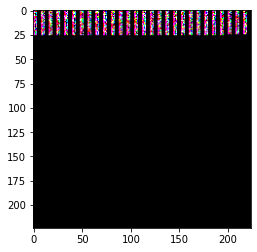

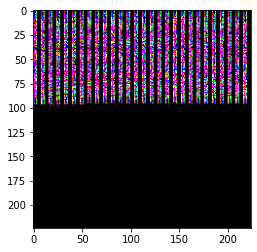

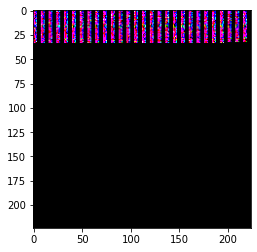

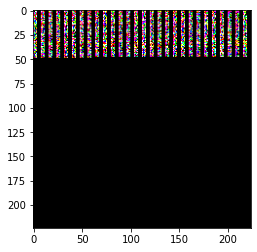

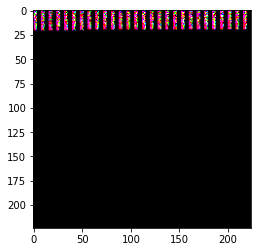

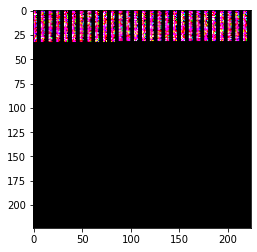

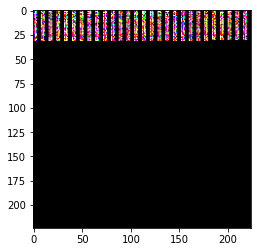

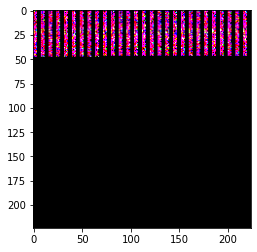

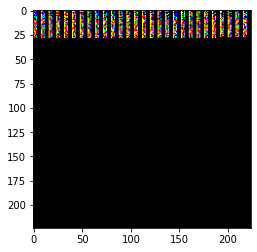

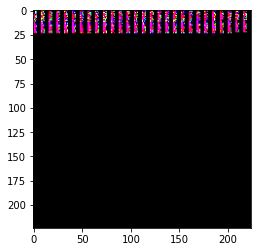

In [ ]:
# # how much padding have we added? (i.e. how much space is there in every sample to add more features into?)

# for i in range(10):
#   plt.figure()
#   plt.imshow(dataset_full[i][1].permute(1, 2, 0))
#   plt.plot()

## Learning to mould the inputs into a desired shape 

(applied to genreClassificationDataset after)

In [ ]:
# # extract features from .h5 file
# h5 = tables.open_file("data/Jazz/TRAADHS12903CE70A9.h5", mode='r')
# segments_timbre = hdf5_getters.get_segments_timbre(h5)
# h5.close()

In [ ]:
# print(type(segments_timbre[0][0]))
# segments_timbre_tensor = torch.tensor(segments_timbre)
# print(segments_timbre_tensor)
# print(segments_timbre_tensor.size())

In [ ]:
# # finding the maximum size of each dimension of segments_timbre
# max_size_dim1 = 0
# max_size_dim2 = 0
# for i in range(len(dataset_full)):
#   if dataset_full[i][1].size()[0] > max_size_dim1:
#     max_size_dim1 = dataset_full[i][1].size()[0]
#   if dataset_full[i][1].size()[1] > max_size_dim2:
#     max_size_dim2 = dataset_full[i][1].size()[1]
# [max_size_dim1, max_size_dim2]

# # For every sample's segments_timbre array, need 3691 items with 12 elements each

In [ ]:
# len(segments_timbre), max_size_dim1 - len(segments_timbre)

In [ ]:
# # padding segments_timbre feature of data/Jazz/TRAADHS12903CE70A9.h5 to max. dimensions of [3691, 12]

# segments_timbre_tensor_padded = segments_timbre_tensor
# for i in range(max_size_dim1 - len(segments_timbre)):
#   segments_timbre_tensor_padded = torch.cat((segments_timbre_tensor_padded, torch.zeros(1,12)))
# print(segments_timbre_tensor_padded)
# print(segments_timbre_tensor_padded.size())

In [ ]:
# # adding a third dimension to segments_timbre_tensor_padded. 
# # This will have two more copies of segments_timbre_tensor_padded, until we find other things to fill it with.

# temp = torch.unsqueeze(segments_timbre_tensor_padded, 0)
# print(temp.size() == torch.Size([1, max_size_dim1, max_size_dim2]))

# st_padded_cloned = torch.cat((temp, temp))
# print(st_padded_cloned.size() == torch.Size([2, max_size_dim1, max_size_dim2]))

# st_padded_cloned = torch.cat((st_padded_cloned, temp))
# print(st_padded_cloned.size() == torch.Size([3, max_size_dim1, max_size_dim2]))


In [ ]:
# # adding the last (outermost) dimension to st_padded_cloned.

# st_padded_cloned = torch.unsqueeze(st_padded_cloned, 0)
# print(st_padded_cloned.size() == torch.Size([1, 3, max_size_dim1, max_size_dim2]))

#M3: Creating a Dictionary of Songs and Youtube Links
... for getting audio samples. Can extract spectrograms from those for genre classification

**Note: We have saved the dictionaries using Pickle so it is not necessary to run this. The dictionaries are stored in the Github Repo.**

In [ ]:
# def search_and_grab_url(search_term):
#   # Search returns a dictionary which contains a list which contains more dictionaries and lists (why...)
#   videosSearch = VideosSearch(search_term, limit = 1)
#   # Here we store the list into result
#   if videosSearch.result().get('result'):
#     results = videosSearch.result().get('result')[0].get('link')
#   else:
#     results = "None"
#   return str(results)

In [ ]:
# dir = "data/"
# # os already imported

# id_list = []
# name_list = []
# youtube_urls = []
# genre_list = []
# artist_list = []

# tracks_in_data = []

# for root, dirs, files in os.walk(dir):
#   for name in files:
#       tracks_in_data.append(os.path.join(root, name))

# for i in tracks_in_data:
#   h5 = tables.open_file(i, mode='r')
#   # Getting search term
#   song_title = str(hdf5_getters.get_title(h5))
#   artist = str(hdf5_getters.get_artist_name(h5))
#   search = song_title + " by " + artist
  
#   # Getting genre
#   genre = (i.split('/'))[1]

#   # Storing the info
#   URL = search_and_grab_url(search)
#   if (URL != "None"):
#     id_list.append(hdf5_getters.get_song_id(h5))
#     name_list.append(song_title)
#     youtube_urls.append(URL)
#     genre_list.append(genre)
#     artist_list.append(artist)
#   h5.close()

In [ ]:
# # Creating a dictionary from the id list and urls
# id_url_dict = dict()
# for i in range (len(id_list)):
#   id_url_dict[id_list[i]] = youtube_urls[i]

# url_genre_dict = dict()
# for i in range (len(youtube_urls)):
#   url_genre_dict[youtube_urls[i]] = genre_list[i]

In [ ]:
# song_to_genre = dict()
# for i in range (len(name_list)):
#   key = artist_list[i][2:-1] + " by " + name_list[i][2:-1]

#   song_to_genre[key] = genre_list[i]

In [ ]:
# # saving url_genre_dictionary
# with open('url_genre_dictionary.pickle', 'wb') as handle:
#     pickle.dump(url_genre_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)

# with open('url_genre_dictionary.pickle', 'rb') as handle:
#     b = pickle.load(handle)

# print (url_genre_dict == b)

# # saving track_id_url_dictionary
# with open('track_id_url_dictionary.pickle', 'wb') as handle:
#     pickle.dump(song_dictionary, handle, protocol=pickle.HIGHEST_PROTOCOL)

# with open('track_id_url_dictionary.pickle', 'rb') as handle:
#     b = pickle.load(handle)

# print (song_dictionary == b)

True


In [ ]:
# # saving song_to_genre
# with open('song_to_genre.pickle', 'wb') as handle:
#     pickle.dump(song_to_genre, handle, protocol=pickle.HIGHEST_PROTOCOL)

# with open('song_to_genre.pickle', 'rb') as handle:
#     b = pickle.load(handle)

# print (song_to_genre == b)

True


#M3: Getting Song Previews

Can try running image classification on spectrograms of this audio.

1. Get 7digital track id from the Million Song Dataset.
2. Request and recieve a 30 second preview of this track.
3. Create a spectrogram of this track.

In [ ]:
# file to try: data/Rock/TRAAAEF128F4273421.h5

# # get 7digital track id
# h5 = tables.open_file("data/Rock/TRAAAEF128F4273421.h5", mode='r')
# x = hdf5_getters.get_track_7digitalid(h5)
# h5.close()

# print(x)

In [ ]:
# # functions to get preview from 7digital track id

# #
# # NEED A 7DIGITAL API KEY! They have been contacted. Hopefully they respond quickly.
# #


# # CITATION: 
# #   Copyright 2010, Thierry Bertin-Mahieux, Columbia University
# #   tb2332@columbia.edu
# #   https://github.com/tbertinmahieux/MSongsDB/blob/master/Tasks_Demos/Preview7digital/get_preview_url.py


# import sys
# import urllib2
# try:
#     from numpy import argmin
# except ImportError:
#     from scipy import argmin
# except ImportError:
#     print ('no argmin function (no numpy or scipy), might cause problems')
# from xml.dom import minidom


# def url_call(url):
#     """
#     Do a simple request to the 7digital API
#     We assume we don't do intense querying, this function is not
#     robust
#     Return the answer as na xml document
#     """
#     stream = urllib2.urlopen(url)
#     xmldoc = minidom.parse(stream).documentElement
#     stream.close()
#     return xmldoc

# def get_preview_from_trackid(trackid):
#     """
#     Ask for the preview to a particular track, get the XML answer
#     After calling the API with a given track id,
#     we get an XML response that looks like:
    
#     <response status="ok" version="1.2" xsi:noNamespaceSchemaLocation="http://api.7digital.com/1.2/static/7digitalAPI.xsd">
#       <url>
#         http://previews.7digital.com/clips/34/6804688.clip.mp3
#       </url>
#     </response>
#     We parse it for the URL that we return, or '' if a problem
#     """
#     url = 'http://api.7digital.com/1.2/track/preview?redirect=false'
#     url += '&trackid='+str(trackid)
#     url += '&oauth_consumer_key='+DIGITAL7_API_KEY
#     xmldoc = url_call(url)
#     status = xmldoc.getAttribute('status')
#     if status != 'ok':
#         return ''
#     urlelem = xmldoc.getElementsByTagName('url')[0]
#     preview = urlelem.firstChild.nodeValue
#     return preview


#M3: Creating a Spectrogram Dataset

While waiting for a 7digital API key, we can try getting the necessary audio from Youtube. Steps:

1. Find the title of a track from the MSD using the reverse-index file provided in http://millionsongdataset.com/sites/default/files/AdditionalFiles/unique_tracks.txt
2. Use Youtube API to search youtube for the song. Find the URL from which to download the song. 

**Note: Instead of steps 1 and 2, we ended up creating a dictionary mapping Youtube URLs to music genre. This is saved in the file "url_genre_dict.pickle".**

3. Use Youtube-dl to download the audio from the URL found.
4. Extract spectrograms from downloaded audio
  - split audio into evenly sized (90-second) chunks and make 3 spectrograms of size (224 x 224) for each chunk. 
  - For each triplet of spectrograms, put together the three spectrograms for a resulting size shape of 3 x 224 x 224. Convert to tensor and store for later use.

## Developing the Spectrogram Extraction Process

In [ ]:
# # get the reverse index file. Format: trackid<SEP>songid<SEP>artist<SEP>song_title
# !wget http://millionsongdataset.com/sites/default/files/AdditionalFiles/unique_tracks.txt

--2021-05-08 02:07:54--  http://millionsongdataset.com/sites/default/files/AdditionalFiles/unique_tracks.txt
Resolving millionsongdataset.com (millionsongdataset.com)... 172.104.14.177
Connecting to millionsongdataset.com (millionsongdataset.com)|172.104.14.177|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 84046293 (80M) [text/plain]
Saving to: ‘unique_tracks.txt’

unique_tracks.txt   100%[===================>]  80.15M  79.5MB/s    in 1.0s    

2021-05-08 02:07:55 (79.5 MB/s) - ‘unique_tracks.txt’ saved [84046293/84046293]



In [ ]:
# # parse the reverse index file to create a trackid:song_title dictionary
# trackid_to_song = {}
# with open("unique_tracks.txt", "r", encoding='utf8') as f:
#   for x in f:
#     line = x.split("<SEP>")
#     song_title = line[3].rstrip('\n')
#     artist = line[2]
#     trackid_to_song[line[0]] = f"{song_title} by {artist}" 

# print(len(trackid_to_song))

1000000


In [ ]:
# # get song title and atist corresponding to trackid TRAAAEF128F4273421
# print(trackid_to_song["TRAAAEF128F4273421"])

Something Girls by Adam Ant


In [ ]:
# Can search for "Something Girls by Adam Ant" on Youtube using the API

# Using the Youtube Data API to search Youtube: https://www.youtube.com/watch?v=b_jOJNUD350
# Data API can give video IDs. Can use them to construct URLs as described in https://stackoverflow.com/questions/51956099/how-to-get-video-url-with-youtube-apiv3
 

In [ ]:
# # Top Youtube search result for "something girls by Adam Ant" was at https://www.youtube.com/watch?v=JMnm29UhNAk (didn't use Youtube API in this case).
# # Let's try downloading the audio with youtube-dl

# url = 'https://www.youtube.com/watch?v=JMnm29UhNAk'

# ydl_opts = {
#     'format': 'bestaudio/best',
#     'outtmpl': './downloadedsongs/%(title)s.%(ext)s',
#     'postprocessors': [{
#         'key': 'FFmpegExtractAudio',
#         'preferredcodec': 'wav',
#         'preferredquality': '192',
#     }]
# }

# with youtube_dl.YoutubeDL(ydl_opts) as ydl:
#     ydl.download([url])
#     # info = ydl.extract_info(url, download=False)

# # documentation for youtube-dl: https://github.com/ytdl-org/youtube-dl/blob/master/README.md#embedding-youtube-dl

[youtube] JMnm29UhNAk: Downloading webpage
[download] Destination: ./downloadedsongs/Something Girls.m4a
[download] 100% of 3.58MiB in 00:00
[ffmpeg] Correcting container in "./downloadedsongs/Something Girls.m4a"
[ffmpeg] Destination: ./downloadedsongs/Something Girls.wav
Deleting original file ./downloadedsongs/Something Girls.m4a (pass -k to keep)


A success! We have audio. Time to make a spectrogram for "Something Girls" by Adam Ant.

Reference for extracting audio spectrograms:

- "How to Extract Spectrograms from Audio with Python", https://www.youtube.com/watch?v=3gzI4Z2OFgY


In [ ]:
# song_file = "./downloadedsongs/Something Girls.wav"

In [ ]:
# def num_spectrograms_possible(song_file):
#   read = wave.open(song_file)
#   framerate = read.getframerate() # get sample rate
#   numframes = read.getnframes()   # get number of samples
#   duration = numframes/framerate  # duration of song: frames/frames-per-second = seconds
#   # print(duration)

#   # compute the number of 90 second clips available in this file
#   num_spectrograms = int(duration / 90)
#   return num_spectrograms

In [ ]:
# num_spectrograms_possible(song_file)

2

In [ ]:
# # getting 90 second clips from the file, in three 30-second chunks each. Each clip will be one channel of VGG input.
# # CITATION: https://stackoverflow.com/questions/37999150/how-to-split-a-wav-file-into-multiple-wav-files

# # Returns a 2-d array containing 90-second clips from a wav file in 3 chunks of 30 each.
# # Each chunk corresponsd to one channel of a spectrogram to be fed into VGG-19 
# def get_song_clips(song_file):
#   # song_file = song_file.split('/')[-1]
#   audio = AudioSegment.from_wav(song_file)
#   song_files = []
#   for j in range(num_spectrograms_possible(song_file)):
#     clips = []
#     for i in range(3):
#       t1 = (j*90*1000) + (i*30) * 1000 #Works in milliseconds
#       t2 = (j*90*1000) + (i*30 + 30) * 1000
#       newAudio = audio[t1:t2]
#       newAudio.export(f'{j*90 + i*30}to{j*90 + i*30 + 30}-' + song_file.split('/')[-1], format="wav") #Exports to a wav file in the current path.
#       clips.append(f'{j*90 + i*30}to{j*90 + i*30 + 30}-' + song_file.split('/')[-1])
#     song_files.append(clips)
#   return song_files

In [ ]:
# song_files = get_song_clips(song_file) 

In [ ]:
# for clips in song_files:
#   for x in clips:
#     print(x)

0to30-Something Girls.wav
30to60-Something Girls.wav
60to90-Something Girls.wav
90to120-Something Girls.wav
120to150-Something Girls.wav
150to180-Something Girls.wav


Taking a listen to the three 30 second clips from the song file...

In [ ]:
# print(song_files[0][0])
# ipd.Audio(song_files[0][0])

0to30-Something Girls-JMnm29UhNAk.wav


In [ ]:
# print(song_files[0][1])
# ipd.Audio(song_files[0][1])

30to60-Something Girls-JMnm29UhNAk.wav


In [ ]:
# print(song_files[0][2])
# ipd.Audio(song_files[0][2])

60to90-Something Girls-JMnm29UhNAk.wav


Loading audio files with Librosa...

In [ ]:
# # Loads audio files from get_song_clips() into librosa.
# # Returns a numpy array representing those clips. 
# def librosa_load_song_clips(song_files):
#   song_clips = []
#   for clips in song_files:
#     song_chunks = []
#     for chunks in clips:
#       song, sr = librosa.load(chunks)
#       song_chunks.append(song)
#       # print(sr)
#     song_clips.append(song_chunks)
#   return song_clips

In [ ]:
# song_clips = librosa_load_song_clips(song_files)

In [ ]:
# print(len(song_clips))
# for i in range(len(song_clips)):
#   for j in range(len(song_clips[i])):
#     print(len(song_clips[i][j]))
#     print(type(song_clips[i][j]))

2
661500
<class 'numpy.ndarray'>
661500
<class 'numpy.ndarray'>
661500
<class 'numpy.ndarray'>
661500
<class 'numpy.ndarray'>
661500
<class 'numpy.ndarray'>
661500
<class 'numpy.ndarray'>


In [ ]:
# # Takes 2-d array of numpy arrays representing 90-second song clips, each split into 3 separate numpy arrays, 
# # all loaded into librosa. Returns the element-wise stft (short time fourier transform) 
# # of the input array (i.e. a 2x3 array of short-time Fourier transforms).
# def get_stft_of_clips(song_clips):
#   # extracting short-time fourier transform
#   FRAME_SIZE = 446 # frame size chosen such that frequency_bins = frame_size/2 - 1 = 224
#   HOP_SIZE = 2965  # Hop size chosen such that num_frames = (samples - frame_size)/ hop_size + 1 = 224 
#                    # Output shape of the stft is (frequency_bins, num_frames). Desired: (224, 224)
#   stft = []
#   for i in range(len(song_clips)):
#     channels = []
#     for j in range(len(song_clips[i])):
#       channels.append(librosa.stft(song_clips[i][j], n_fft=FRAME_SIZE, hop_length=HOP_SIZE))
#     stft.append(channels)
#   return stft

In [ ]:
# stft = get_stft_of_clips(song_clips)

In [ ]:
# print((stft[0][0].shape, stft[0][1].shape, stft[0][2].shape))
# print((stft[0][0].shape, stft[0][1].shape, stft[0][2].shape))

((224, 224), (224, 224), (224, 224))
((224, 224), (224, 224), (224, 224))


In [ ]:
# type(stft[0][0][0][0])

numpy.complex64

In [ ]:
# # Calculates and returns the spectrograms of each element in the input numpy array.
# # The input numpy array must be the output of get_stft_of_clips().
# def calculate_spectrograms(stft):
#   specs = []
#   for i in range(len(stft)):
#     channels = []
#     for j in range(len(stft[i])):
#       channels.append(np.abs(stft[i][j]) ** 2)
#     specs.append(channels)
#   return specs

In [ ]:
# specs = calculate_spectrograms(stft)

In [ ]:
# specs[0][0].shape

(224, 224)

In [ ]:
# type(specs[0][0][0][0])

numpy.float32

In [ ]:
# # Visualizing the spectrogram
# def plot_spectrogram(Y, sr=22050, hop_length=2965, y_axis="linear"):
#   fig = plt.figure(figsize=(25,10))
#   # plt.axis('off')
#   librosa.display.specshow(
#       Y,
#       sr=sr,
#       hop_length=hop_length,
#       x_axis="time",
#       y_axis=y_axis
#   )
#   plt.colorbar(format="%+2.f")
#   return fig

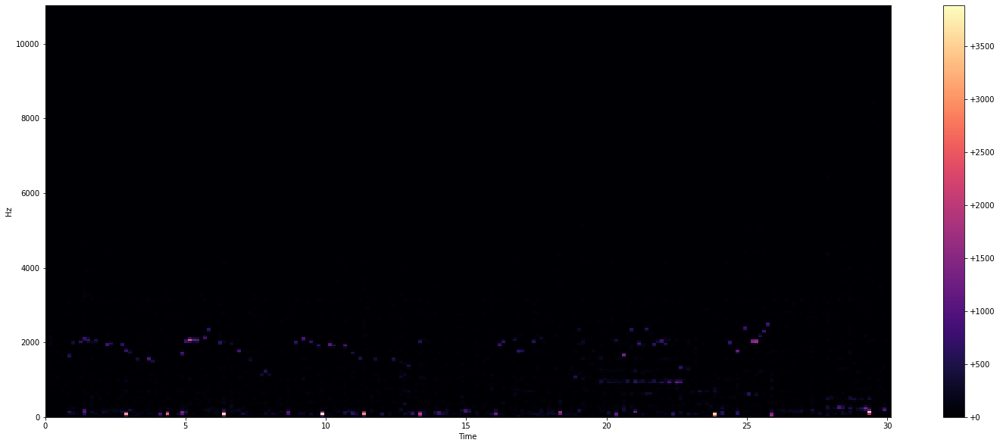

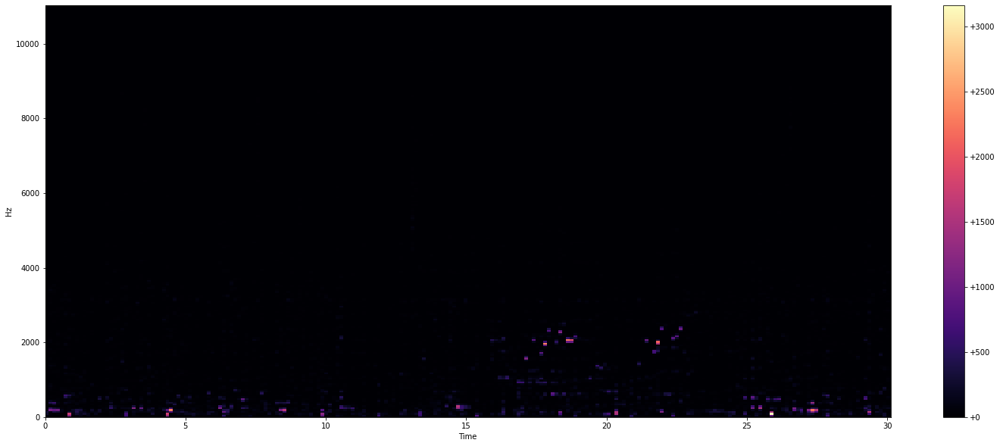

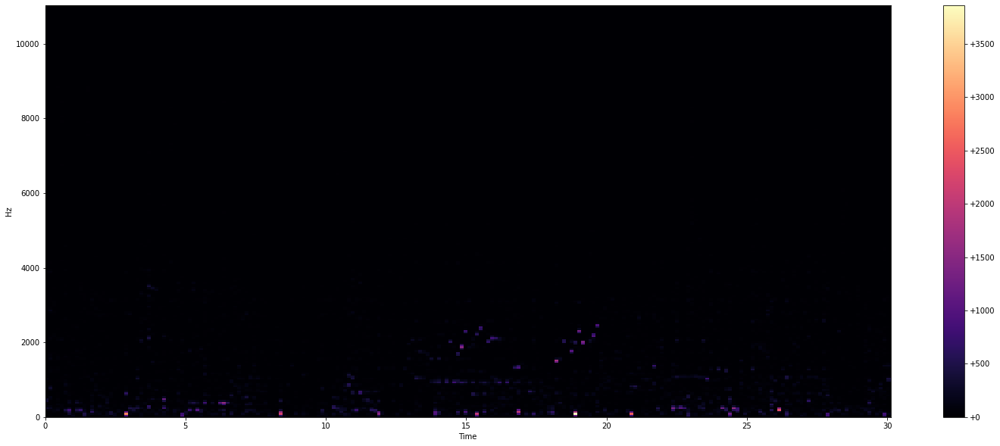

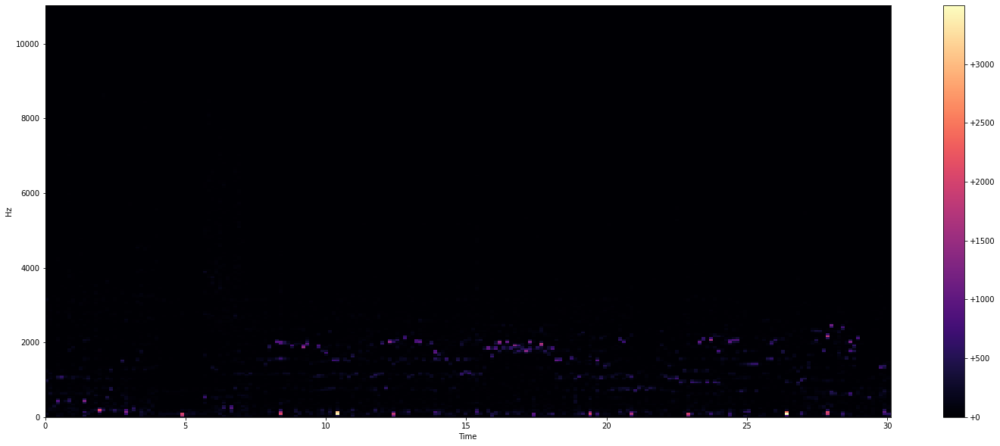

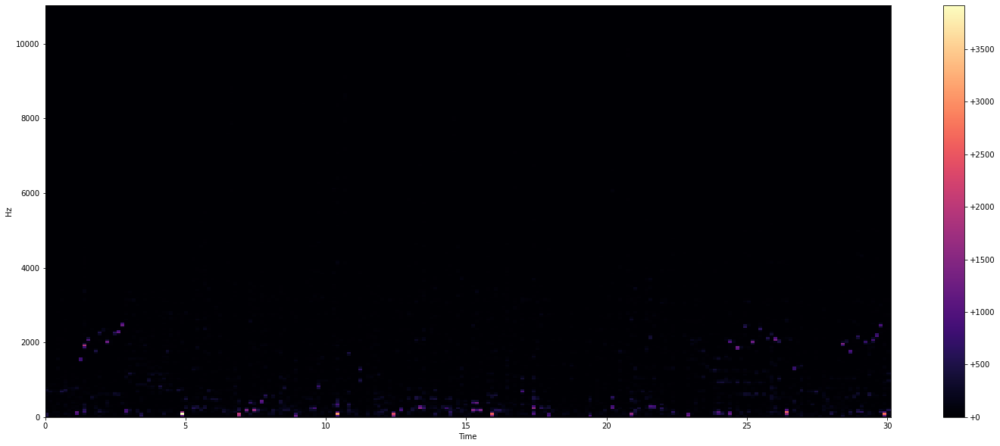

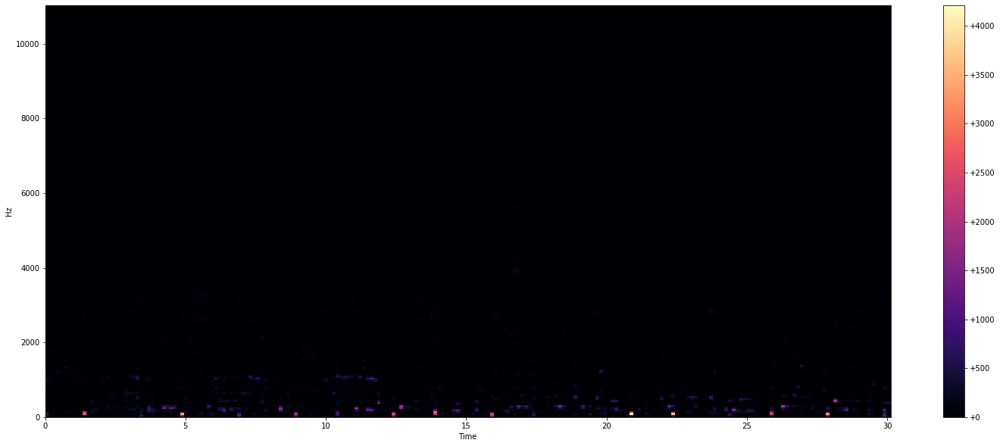

In [ ]:
# _ = plot_spectrogram(specs[0][0], 22050, 2965) # 22050 is sampling rate, 2965 is hop_size
# _ = plot_spectrogram(specs[0][1], 22050, 2965)
# _ = plot_spectrogram(specs[0][2], 22050, 2965)
# _ = plot_spectrogram(specs[1][0], 22050, 2965)
# _ = plot_spectrogram(specs[1][1], 22050, 2965)
# _ = plot_spectrogram(specs[1][2], 22050, 2965)

In [ ]:
# # compute and return the log-amplitude spectrograms for the spectrograms created 
# # by calculate_spectrograms

# def log_amplitude_transform(specs):
#   log_specs = []
#   for i in range(len(specs)):
#     channels = []
#     for j in range(len(specs[i])):
#       log_converted_spec = librosa.power_to_db(specs[i][j])
#       channels.append(log_converted_spec)
#       # _ = plot_spectrogram(log_converted_spec, 22050, 2965)
#     log_specs.append(channels)
#   return log_specs

In [ ]:
# log_specs = log_amplitude_transform(specs)

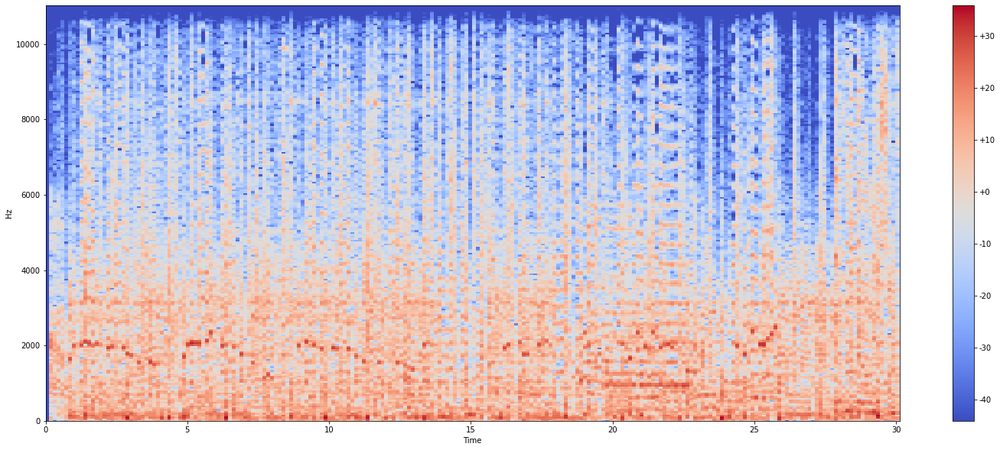

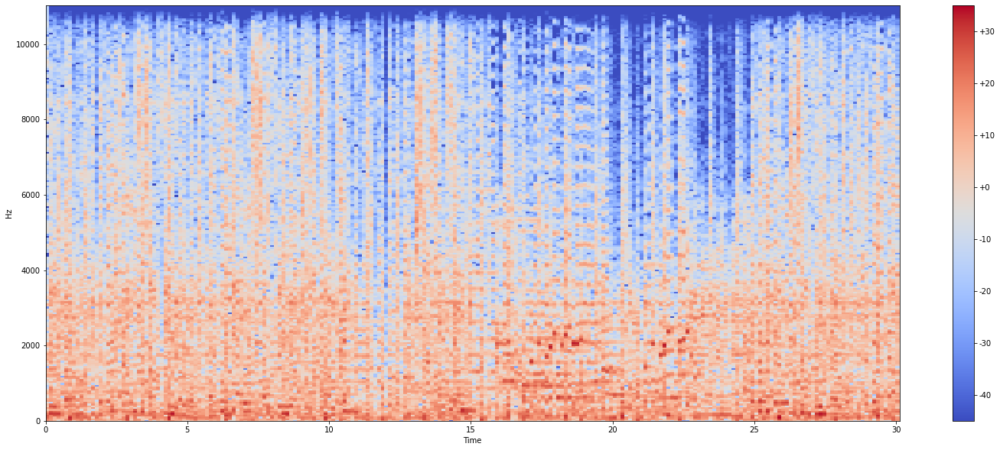

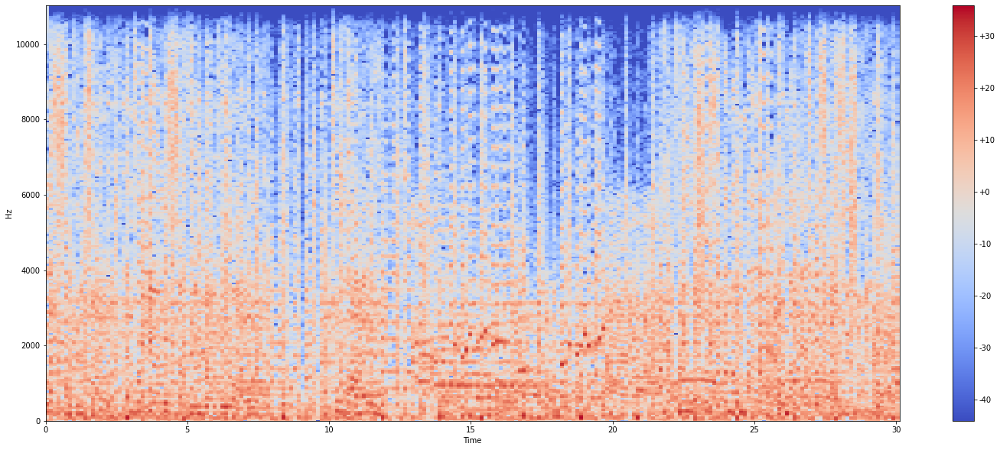

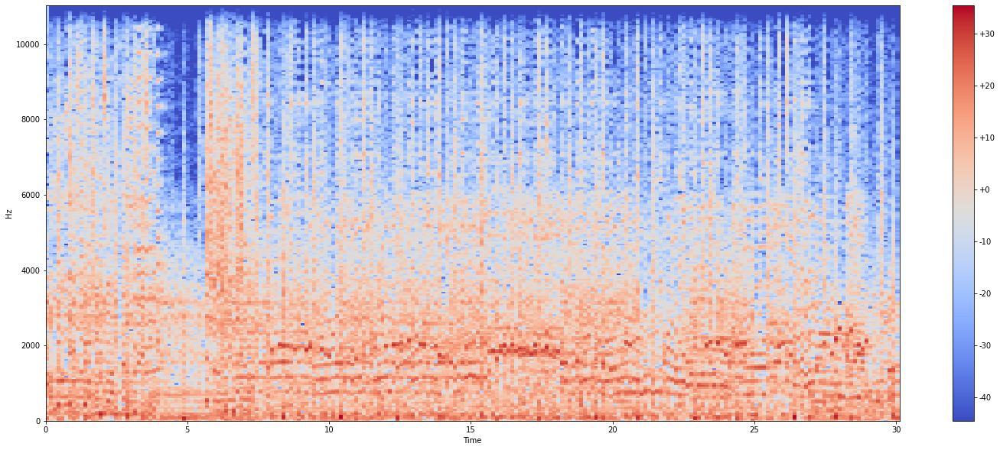

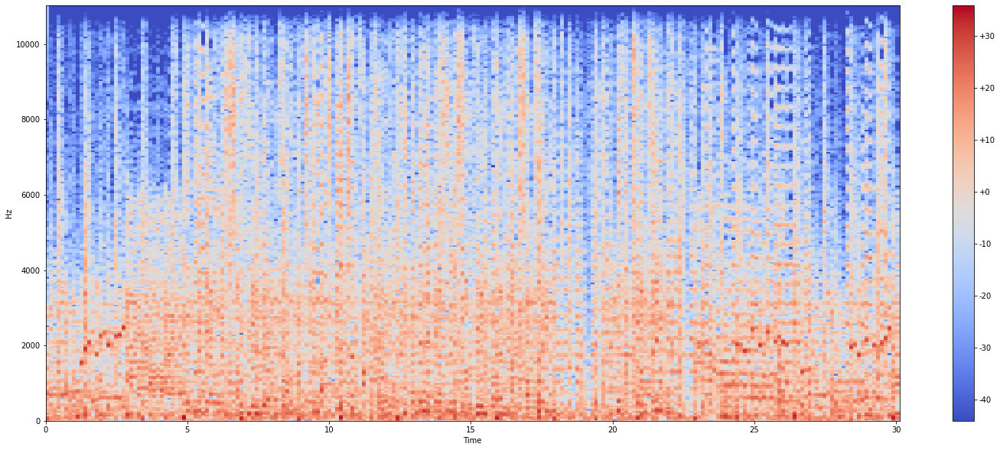

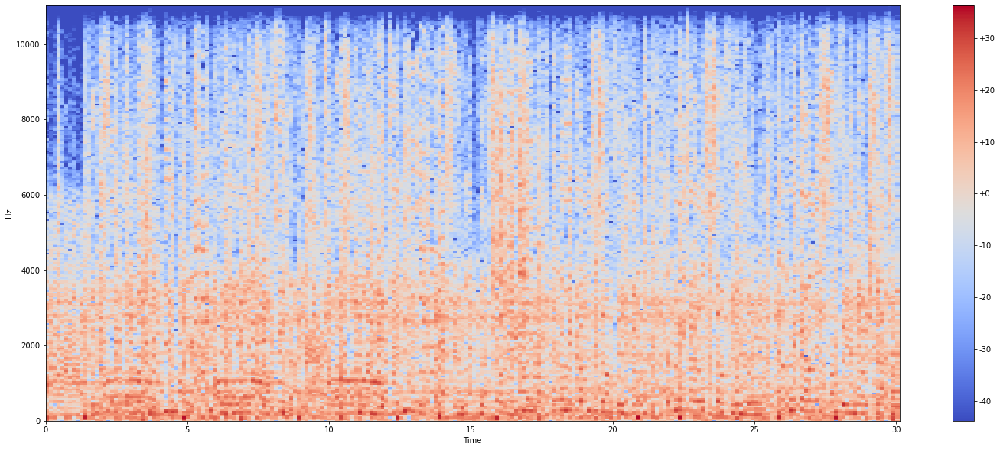

In [ ]:
# _ = plot_spectrogram(log_specs[0][0], 22050, 2965) # 22050 is sampling rate, 2965 is hop_size
# _ = plot_spectrogram(log_specs[0][1], 22050, 2965)
# _ = plot_spectrogram(log_specs[0][2], 22050, 2965)
# _ = plot_spectrogram(log_specs[1][0], 22050, 2965)
# _ = plot_spectrogram(log_specs[1][1], 22050, 2965)
# _ = plot_spectrogram(log_specs[1][2], 22050, 2965)

In [ ]:
# # Let the output of log_amplitude_transform() be called log_specs. 
# # This function transforms x[i][:] into tensors of size (3 x 224 x 224)
# def log_specs_to_image_tensors(log_specs):
#   imgs = []
#   for i in range(len(log_specs)):
#     img = torch.tensor(log_specs[i])
#     # print(img.size())
#     imgs.append(img)
#   return imgs

In [ ]:
# imgs = log_specs_to_image_tensors(log_specs)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


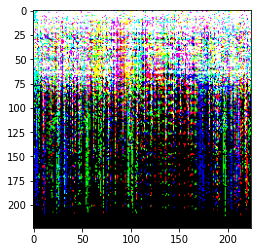

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


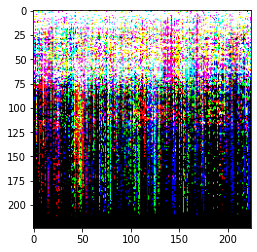

In [ ]:
# # visualize
# for x in imgs:
#   plt.figure()
#   plt.imshow(x.permute(1,2,0))
#   plt.show()


Retrieving the first channel of the first spectrogram above to check that the conversion from tensor to numpy array by log_specs_to_image_tensors(log_specs) is bug free. The expected output is the first log-amplitude spectrogram of the six generated for "Something Girls" by Adam Ant. 

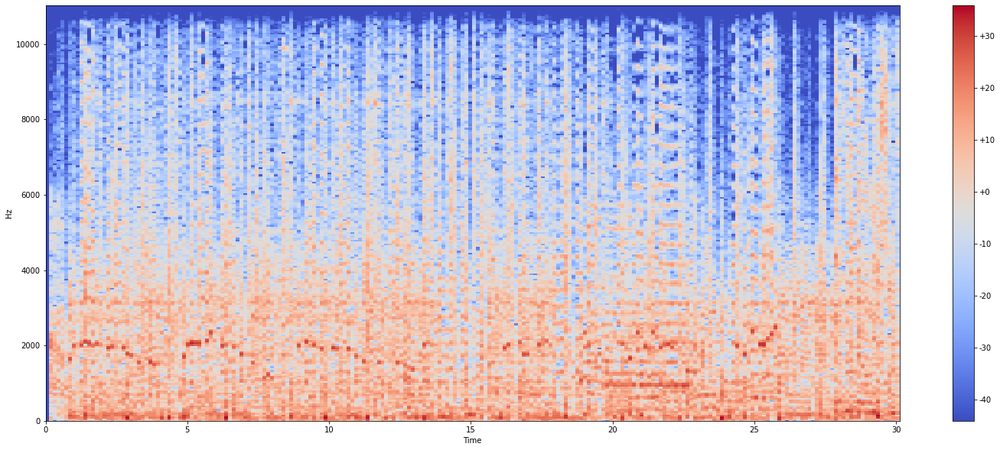

In [ ]:
# spec = np.array(imgs[0][0])
# _ = plot_spectrogram(spec)

Success! The funtion log_specs_to_image_tensors(log_specs) works as intended.

In [ ]:
# # Putting everything together: The Spectrogram Extraction Process

# # A funtion that takes in the name of a song file (that is assumed to exist), 
# # and returns a list of spectrograms of size (3 x 224 x 224) 
# def get_3channel_spectrograms(song_file):
#   # get 90-second song clips, in three 30-second chunks each
#   file_names = get_song_clips(song_file)
#   # load song clips to librosa
#   song_clips = librosa_load_song_clips(file_names)
#   # calculate stft's of each clip
#   stft = get_stft_of_clips(song_clips)
#   # calculate spectrograms based on stft's
#   specs = calculate_spectrograms(stft)
#   # transform spectrograms to log-amplitude
#   log_specs = log_amplitude_transform(specs)
#   # create 3-channel image tensors from each set of 3 spectrograms in log_specs
#   imgs = log_specs_to_image_tensors(log_specs)
#   return imgs

# # a function to delete all intermediate wav files
# def remove_intermediate_wav_files(song_file):
#   j = 0
#   i = 0
#   for j in range(num_spectrograms_possible(song_file)):
#     for i in range(3):
#       os.remove(f'{j*90 + i*30}to{j*90 + i*30 + 30}-' + song_file.split('/')[-1])

In [ ]:
# imgs = get_3channel_spectrograms(song_file)
# remove_intermediate_wav_files(song_file)
# os.remove(song_file)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


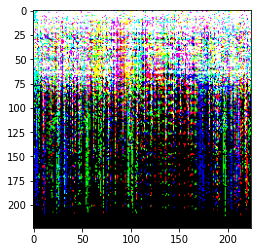

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


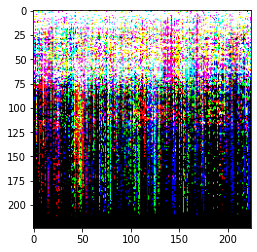

In [ ]:
# # visualize
# for x in imgs:
#   plt.figure()
#   plt.imshow(x.permute(1,2,0))
#   plt.show()

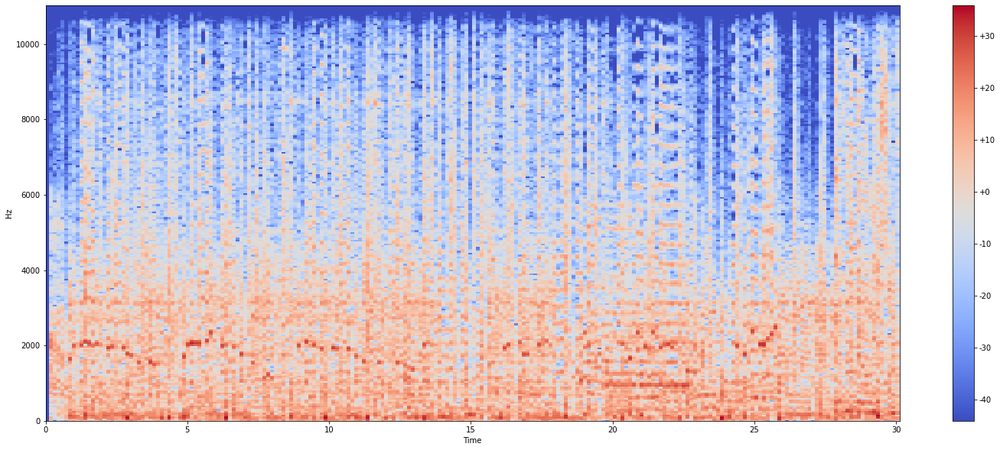

In [ ]:
# spec = np.array(imgs[0][0])
# _ = plot_spectrogram(spec)

## Creating the Spectrogram Dataset

**This section does not need to be run - it takes approximately 10 hours to run completely.** 

**The generated spectrograms are available at https://drive.google.com/drive/folders/1-1F4SpcoQwlEfq_EHNELffYD-r3O0KP0?usp=sharing and will be downloaded in the next section ("M3: Creating a Custom Dataset Class for Spectrogram Dataset") before instantiating a dataset class.**



In [ ]:
# # mount google drive
# from google.colab import drive
# drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# !mkdir /content/drive/MyDrive/spectrograms/SpectrogramBlues
# !mkdir /content/drive/MyDrive/spectrograms/SpectrogramCountry
# !mkdir /content/drive/MyDrive/spectrograms/SpectrogramElectronic
# !mkdir /content/drive/MyDrive/spectrograms/SpectrogramFolk
# !mkdir /content/drive/MyDrive/spectrograms/SpectrogramJazz
# !mkdir /content/drive/MyDrive/spectrograms/SpectrogramLatin
# !mkdir /content/drive/MyDrive/spectrograms/SpectrogramRap
# !mkdir /content/drive/MyDrive/spectrograms/SpectrogramRock

### Filtering Potential Audio Samples' YouTube URLs 
In the section "Creating a Dictionary of Songs and Youtube Links," the the dictionary url_genre_dict was created, and saved using Pickle. It has URLs for keys and a music genre for items. 

Having found URLs with music-unrelated content in url_genre_dict, we want to filter those out.

Examples of music-unrelated content in url_genre_dict (unfiltered):
- 3 Hour Minecraft stream in German
- an Economics seminar

and many more.

In [ ]:
# # load url_genre_dict from pickle
# url_genre_dict_unfiltered = {}
# with open('/content/drive/MyDrive/pickles/url_genre_dictionary.pickle', 'rb') as handle:
#     url_genre_dict_unfiltered = pickle.load(handle)

# print(len(url_genre_dict_unfiltered))

1574


In [ ]:
# # checking for repeats in url_genre_dict
# repeats = 0
# for x in url_genre_dict:
#   for y in url_genre_dict:
#     if x == y: repeats += 1
# repeats > len(url_genre_dict) # if false, then there are no repeated urls. Especially, we assume that songs are not repeated across genres

False

In [ ]:
# # load url_genre_dict (filtered, incomplete) from pickle
# url_genre_dict = {}
# with open('/content/drive/MyDrive/pickles/url_genre_dictionary_filtered.pickle', 'rb') as handle:
#   url_genre_dict = pickle.load(handle)

# print(len(url_genre_dict))

192


In [ ]:
# # clearing url_genre_dictionary (filtered) if we need to start filtering process over again.
# url_genre_dict = {}

In [ ]:
# # filter out bad urls. Bad urls are urls that contain videos unrelated to/not including the music audio samples we need GYBtW6QaONk, rzokl_iK3Jo repeated
# count = 0
# for x in url_genre_dict_unfiltered:
#   if count > 1459: # set the right operand of "count > ___" to whatever value i it was last when you paused the url filtering. Then the filtering should resume on the (i+1)^th url.
#     # get genre
#     genre = url_genre_dict_unfiltered[x]
#     # get info about url. url == x
#     ydl_opts = {
#           'format': 'bestaudio/best',
#           # 'outtmpl' : desired_filename,
#           'postprocessors': [{
#               'key': 'FFmpegExtractAudio',
#               'preferredcodec': 'wav',
#               'preferredquality': '192',
#           }]
#     }
#     with youtube_dl.YoutubeDL(ydl_opts) as ydl:
#       try:
#         info = ydl.extract_info(x, download=False)
#         # if the url contains a video related to music, include it in url_genre_dict (filtered)
#         filter = ( 
#           ("Music" in info["categories"]) and 
#           (info["duration"] < 600) 
#         )
#         if filter:
#           url_genre_dict[x] = genre
#       except youtube_dl.DownloadError:
#         print("video unavailable")
#     # wait for 5 seconds between each request for info from YouTube
#     time.sleep(5)
#   count += 1

# print(len(url_genre_dict)) 

[youtube] Mh7CBk6qsI4: Downloading webpage
[youtube] KO3IDdTcXx8: Downloading webpage
[youtube] _d8Y8WFTwcs: Downloading webpage


ERROR: Video unavailable
This video is not available


video unavailable
[youtube] gzhmI6U6sAs: Downloading webpage
[youtube] 3N9Gem0HoSo: Downloading webpage
[youtube] 4BJmUMAmUv8: Downloading webpage
[youtube] jTtxt5FofB0: Downloading webpage
[youtube] jTtxt5FofB0: Downloading MPD manifest
[youtube] vIwz1vBX0RI: Downloading webpage
[youtube] ANImnnK9zOU: Downloading webpage
[youtube] ANImnnK9zOU: Downloading MPD manifest
[youtube] HWWjTK1XGJs: Downloading webpage
[youtube] 5mCH_zIABls: Downloading webpage
[youtube] iXt1NIYPNjA: Downloading webpage
[youtube] BUx2uHsRKCU: Downloading webpage
[youtube] BUx2uHsRKCU: Downloading MPD manifest
[youtube] TFHGtsk9Pmk: Downloading webpage
[youtube] j3IaovkDNyw: Downloading webpage
[youtube] XFfLnvoV5JA: Downloading webpage
[youtube] _s4TDxI3BEA: Downloading webpage
[youtube] 8rhvmaKaaMk: Downloading webpage
[youtube] -BLR5R8b-Ao: Downloading webpage
[youtube] hWpooSTxwKs: Downloading webpage
[youtube] hWpooSTxwKs: Downloading MPD manifest
[youtube] U18EczEH_AA: Downloading webpage
[youtube] WaZpdK

ERROR: Video unavailable
This video is not available


video unavailable
[youtube] sFav9P54JUA: Downloading webpage
[youtube] x-skFgrV59A: Downloading webpage
[youtube] 3BaVb8LTooU: Downloading webpage
[youtube] z_o-MEIruNU: Downloading webpage
[youtube] UlSMV-JvD0A: Downloading webpage
[youtube] V_EUY0JKi3w: Downloading webpage
[youtube] PxCbceG-hes: Downloading webpage
[youtube] KcBKsJcFgxE: Downloading webpage
[youtube] GQyF3EFQxPQ: Downloading webpage
[youtube] TIkOpX_hU0U: Downloading webpage
[youtube] TIkOpX_hU0U: Downloading MPD manifest
[youtube] QFIqFykobt0: Downloading webpage
[youtube] LertAlqDFGk: Downloading webpage
[youtube] sgJXbIP83A8: Downloading webpage
[youtube] vUbrXyiM6pw: Downloading webpage
[youtube] vUbrXyiM6pw: Downloading MPD manifest
[youtube] f0mBFiqv76I: Downloading webpage
[youtube] qP2xC02iB_o: Downloading webpage
[youtube] vtbDB4jaChQ: Downloading webpage
[youtube] -spnHU7LZqo: Downloading webpage
[youtube] 5Rq-1VeiDw8: Downloading webpage
[youtube] kNhWc1Yf3t8: Downloading webpage
[youtube] S6M6jMF4dTQ: Dow

In [ ]:
# count

1574

In [ ]:
# len(url_genre_dict)

1063

In [ ]:
# # checking for repeats in url_genre_dict (filtered)
# repeats = 0
# for x in url_genre_dict:
#   for y in url_genre_dict:
#     if x == y: repeats += 1
# repeats > len(url_genre_dict) # if false, then there are no repeated urls. Especially, we assume that songs are not repeated across genres

False

In [ ]:
# # saving url_genre_dict (filtered) with pickle
# with open('/content/drive/MyDrive/pickles/url_genre_dictionary_filtered.pickle', 'wb') as handle:
#     pickle.dump(url_genre_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [ ]:
# # checking if url_genre_dict (filtered) has been saved properly
# with open('/content/drive/MyDrive/pickles/url_genre_dictionary_filtered.pickle', 'rb') as handle:
#     b = pickle.load(handle)

# print (url_genre_dict == b)

True


### Generating and Storing Spectrograms
Spectrograms are to be stored in a directory corresponding to the music genre of the songs they represent. 

Directory structure (in mounted Google Drive for convenience):
- in /content/drive/MyDrive/spectrograms
  - ./SpectrogramBlues
  - ./SpectrogramCountry
  - ./SpectrogramElectronic
  - ./SpectrogramFolk
  - ./SpectrogramJazz
  - ./SpectrogramLatin
  - ./SpectrogramRap
  - ./SpectrogramRock

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# # getting url_genre_dict (filtered) from /content/drive/MyDrive/pickles/url_genre_dictionary_filtered.pickle
# # load url_genre_dict from pickle
# url_genre_dict = {}
# with open('/content/drive/MyDrive/pickles/url_genre_dictionary_filtered.pickle', 'rb') as handle:
#     url_genre_dict = pickle.load(handle)

# print(len(url_genre_dict))

1063


In [ ]:
# url_genre_dict

{'https://www.youtube.com/watch?v=yWY33B_sHjY': 'Rock',
 'https://www.youtube.com/watch?v=xKHUwfFb2lw': 'Rock',
 'https://www.youtube.com/watch?v=-PqHj2tdt8A': 'Rock',
 'https://www.youtube.com/watch?v=ewfGisMeLRg': 'Rock',
 'https://www.youtube.com/watch?v=rh7OB8x_uhM': 'Rock',
 'https://www.youtube.com/watch?v=gu1_eWOYlUo': 'Rock',
 'https://www.youtube.com/watch?v=BICxJT1ns-E': 'Rock',
 'https://www.youtube.com/watch?v=pqkNbG3LXK0': 'Rock',
 'https://www.youtube.com/watch?v=NIGMUAMevH0': 'Rock',
 'https://www.youtube.com/watch?v=QofscOivt6Y': 'Rock',
 'https://www.youtube.com/watch?v=6YHdJbfFzfA': 'Rock',
 'https://www.youtube.com/watch?v=sdv6uag1yo4': 'Rock',
 'https://www.youtube.com/watch?v=QxmmFH5mOxE': 'Rock',
 'https://www.youtube.com/watch?v=0eR07k6RrWc': 'Rock',
 'https://www.youtube.com/watch?v=hBft3H93K2c': 'Rock',
 'https://www.youtube.com/watch?v=CzDdRmIGxsY': 'Rock',
 'https://www.youtube.com/watch?v=Z5-sWD8ploc': 'Rock',
 'https://www.youtube.com/watch?v=2KMMKYdR-_g': 

In [ ]:
# ydl_opts = {
#   'format': 'bestaudio/best',
#   'postprocessors': [{
#     'key': 'FFmpegExtractAudio',
#     'preferredcodec': 'wav',
#     'preferredquality': '192',
#   }]
# }

# # if you want to pause progress:
# #   - record num_spectrograms_created and count
# # When you resume:
# #   - set num_spectrograms_created to the value you paused at.
# #   - set the value you compare count against in the line "if (count > VALUE):" to be value of count you paused at

# # REQUIRES: no wav files in /content/

# count = 0
# num_spectrograms_created = 2346  # If progress paused and you want to resume, set this to whatever number of spectrograms you left off at
# for key in url_genre_dict:
#   # get url
#   url = key
#   # find genre of url
#   genre = url_genre_dict[key]
  
#   if (count > 1063): # Set the right operand of "count > ___" to whatever value i 
#                     # it was last when you paused the url filtering. Then the 
#                     # spectrogram extraction should resume on the (i+1)^th url.

#     # download audio into root directory 
#     with youtube_dl.YoutubeDL(ydl_opts) as ydl:
#       try:      
#         ydl.download([url])
#       except youtube_dl.DownloadError: # if unable to download, wait 5 s before next request and increment count
#         print("video unavailable")
#         time.sleep(5)
#         count += 1
#         continue

#     # getting path components to save extracted spectrograms in the appropriate folder
#     genre_spectrogram_folder = f"Spectrogram{genre}"
#     target_directory = f"/content/drive/MyDrive/spectrograms/{genre_spectrogram_folder}"
    
#     # spectrogram extraction
#     song_file_name = "" # find the name of the wav file in /content. Should be the only one in each iteration.
#     for f in os.listdir("/content/"):
#       if f.endswith(".wav"): 
#         song_file_name = f 
#     imgs = get_3channel_spectrograms(song_file_name)

#     # removing downloaded audio samples and intermediate wav files
#     remove_intermediate_wav_files(song_file_name)
#     os.remove(song_file_name)   # remove original wav file

#     # save extracted spectrograms in target directory as .pt files
#     for y in imgs:
#       target_path = f"{target_directory}/{num_spectrograms_created}.pt"
#       torch.save(y, target_path)
#       num_spectrograms_created += 1

#     # wait for 5 seconds before next request to YouTube
#     time.sleep(5)

#   count += 1

In [ ]:
# count, num_spectrograms_created

(1063, 2346)

In [ ]:
# # checking which video comes after element number COUNT in url_genre_dict
# z = 0
# for y in url_genre_dict:
#   if z == 1064:
#     print(y, url_genre_dict[y])
#   z += 1

#### M4: Getting More Folk Songs

Extracting folk songs from playlist that Cassiel found (14 May 2021).

In [ ]:
# ydl_opts = {
#     'format': 'bestaudio/best',
#     'outtmpl': './downloadedsongs/%(title)s.%(ext)s',
#     'postprocessors': [{
#         'key': 'FFmpegExtractAudio',
#         'preferredcodec': 'wav',
#         'preferredquality': '192',
#     }]
# }

# url = 'https://www.youtube.com/playlist?list=PLSBbaSorz_SgXOYjacYYbGDEJhMk8lpcw'

First, let's check whether there are any urls in the playlist that are repeats of urls from which we have already extracted spectrograms from. We need to discard such repeats, especially if the repeats are in different genres; don't want to mix data between categories in our dataset. 

Of course, we might get repeats from different urls. However these additions to our dataset should improve this genre classifier's accuracy anyways, as long as the songs in the playlist have accurately been classified as Folk songs by the playlist's creator (that way, cross-genre repeats are less likely). 

When storing these extra samples in ./drive/MyDrive/spectrograms/SpectrogramFolk, will start naming them with format \<number\>.pt where number starts with 1064 and increases.

In [ ]:
# # get urls from the playlist
# with youtube_dl.YoutubeDL(ydl_opts) as ydl:
#   info = ydl.extract_info(url, download=False)

[youtube:tab] PLSBbaSorz_SgXOYjacYYbGDEJhMk8lpcw: Downloading webpage
[download] Downloading playlist: the list of 100 best folk songs
[youtube:tab] Downloading page 1
[youtube:tab] playlist the list of 100 best folk songs: Downloading 114 videos
[download] Downloading video 1 of 114
[youtube] XaI5IRuS2aE: Downloading webpage
[download] Downloading video 2 of 114
[youtube] vWwgrjjIMXA: Downloading webpage
[download] Downloading video 3 of 114
[youtube] 2SfPyg-mGhU: Downloading webpage
[download] Downloading video 4 of 114
[youtube] ecyI0SM85YE: Downloading webpage
[download] Downloading video 5 of 114
[youtube] KP_MDIYhPH0: Downloading webpage
[download] Downloading video 6 of 114
[youtube] n_56ep729TE: Downloading webpage
[download] Downloading video 7 of 114
[youtube] M_Ld8JGv56E: Downloading webpage
[download] Downloading video 8 of 114
[youtube] B3m7ckGhnsc: Downloading webpage
[download] Downloading video 9 of 114
[youtube] 08lVuhv_Va8: Downloading webpage
[download] Downloading v

In [ ]:
# len(info["entries"])

114

In [ ]:
# # https://stackoverflow.com/questions/43910501/how-do-i-retrieve-individual-video-urls-from-a-playlist-using-youtube-dl-within
# new_urls = [info["entries"][i]["webpage_url"] for i in range(len(info["entries"]))]

In [ ]:
# len(new_urls)

114

In [ ]:
# i = 0
# url_repeats = []
# cross_genre_url_repeats = []
# for i in range(len(new_urls)):
#   for link in url_genre_dict:
#     if link == new_urls[i]:
#       url_repeats.append(new_urls[i])
#       if url_genre_dict[link] != "Folk":
#         cross_genre_url_repeats.append(new_urls[i])
  

In [ ]:
# url_repeats

[]

In [ ]:
# cross_genre_url_repeats

[]

Sweet. It looks like no url repeats exist. Time to download the songs in this playlist.

In [ ]:
# with youtube_dl.YoutubeDL(ydl_opts) as ydl:
#     ydl.download([url])

In [ ]:
# len(os.listdir("./downloadedsongs"))

97

Downloaded 110 of 114 songs in the playlist. Time for spectrogram extraction.

In [ ]:
# count = 0
# num_spectrograms_created = 1225
# for wav_file in os.listdir("./downloadedsongs"):
#   wav_file = "./downloadedsongs/" + wav_file
#   if (count > 73):
#     # set the directory to which we will be sending the extracted spectrograms
#     target_directory = f"/content/drive/MyDrive/spectrograms/SpectrogramFolk"

#     # extract spectrograms
#     imgs = get_3channel_spectrograms(wav_file)

#     # removing downloaded audio samples and intermediate wav files
#     remove_intermediate_wav_files(wav_file)

#     # save extracted spectrograms in target directory as .pt files
#     for y in imgs:
#       target_path = f"{target_directory}/{num_spectrograms_created}.pt"
#       print(target_path)
#       torch.save(y, target_path)
#       num_spectrograms_created += 1

#   count += 1


In [ ]:
# count, num_spectrograms_created

(97, 1272)

#### M4: Getting More Jazz Songs

From Matthew's collection: https://drive.google.com/file/d/1MbWUj23QI9Y5EVP0rW9rtLSP_02hE2qa/view?usp=sharing 

In [ ]:
# # https://drive.google.com/file/d/1MbWUj23QI9Y5EVP0rW9rtLSP_02hE2qa/view?usp=sharing

# gdd.download_file_from_google_drive(file_id='1MbWUj23QI9Y5EVP0rW9rtLSP_02hE2qa',
#                                     dest_path='./jazzSpectrograms/spectrograms.zip',
#                                     unzip=True)

Unzipping...Done.


In [ ]:
# !rm ./jazzSpectrograms/spectrograms.zip

In [ ]:
# !mv  -v ./drive/MyDrive/spectrograms/SpectrogramJazz/SpectrogramJazz/* ./drive/MyDrive/spectrograms/SpectrogramJazz/

renamed './drive/MyDrive/spectrograms/SpectrogramJazz/SpectrogramJazz/2346.pt' -> './drive/MyDrive/spectrograms/SpectrogramJazz/2346.pt'
renamed './drive/MyDrive/spectrograms/SpectrogramJazz/SpectrogramJazz/2347.pt' -> './drive/MyDrive/spectrograms/SpectrogramJazz/2347.pt'
renamed './drive/MyDrive/spectrograms/SpectrogramJazz/SpectrogramJazz/2348.pt' -> './drive/MyDrive/spectrograms/SpectrogramJazz/2348.pt'
renamed './drive/MyDrive/spectrograms/SpectrogramJazz/SpectrogramJazz/2349.pt' -> './drive/MyDrive/spectrograms/SpectrogramJazz/2349.pt'
renamed './drive/MyDrive/spectrograms/SpectrogramJazz/SpectrogramJazz/2350.pt' -> './drive/MyDrive/spectrograms/SpectrogramJazz/2350.pt'
renamed './drive/MyDrive/spectrograms/SpectrogramJazz/SpectrogramJazz/2351.pt' -> './drive/MyDrive/spectrograms/SpectrogramJazz/2351.pt'
renamed './drive/MyDrive/spectrograms/SpectrogramJazz/SpectrogramJazz/2352.pt' -> './drive/MyDrive/spectrograms/SpectrogramJazz/2352.pt'
renamed './drive/MyDrive/spectrograms/Spe

#### M4: Getting More Electronic Songs

from Matthew's collection: https://drive.google.com/file/d/1-E1q2PXZ-VbHCjSGdlOD_7tRCcq6KHlQ/view?usp=sharing

In [ ]:
# # https://drive.google.com/file/d/1-E1q2PXZ-VbHCjSGdlOD_7tRCcq6KHlQ/view?usp=sharing
# gdd.download_file_from_google_drive(file_id='1-E1q2PXZ-VbHCjSGdlOD_7tRCcq6KHlQ',
#                                     dest_path='./electronicSpectrograms/spectrograms.zip',
#                                     unzip=True)

Unzipping...Done.


In [ ]:
# !rm -r ./electronicSpectrograms/spectrograms.zip

In [ ]:
# !mv -v ./electronicSpectrograms/SpectrogramElectronic/* ./drive/MyDrive/spectrograms/SpectrogramElectronic/

copied './electronicSpectrograms/SpectrogramElectronic/3000.pt' -> './drive/MyDrive/spectrograms/SpectrogramElectronic/3000.pt'
removed './electronicSpectrograms/SpectrogramElectronic/3000.pt'
copied './electronicSpectrograms/SpectrogramElectronic/3001.pt' -> './drive/MyDrive/spectrograms/SpectrogramElectronic/3001.pt'
removed './electronicSpectrograms/SpectrogramElectronic/3001.pt'
copied './electronicSpectrograms/SpectrogramElectronic/3002.pt' -> './drive/MyDrive/spectrograms/SpectrogramElectronic/3002.pt'
removed './electronicSpectrograms/SpectrogramElectronic/3002.pt'
copied './electronicSpectrograms/SpectrogramElectronic/3003.pt' -> './drive/MyDrive/spectrograms/SpectrogramElectronic/3003.pt'
removed './electronicSpectrograms/SpectrogramElectronic/3003.pt'
copied './electronicSpectrograms/SpectrogramElectronic/3004.pt' -> './drive/MyDrive/spectrograms/SpectrogramElectronic/3004.pt'
removed './electronicSpectrograms/SpectrogramElectronic/3004.pt'
copied './electronicSpectrograms/Sp

In [ ]:
# len(os.listdir("./drive/MyDrive/spectrograms/SpectrogramElectronic/"))

665

In [ ]:
# !rm -r ./electronicSpectrograms/

#### M4: Getting More Blues Songs

from Quinn's collection:
https://drive.google.com/file/d/1hkrlPGhLY-2TuFUKsNetJGWB2j-hXX_u/view?usp=sharing

In [ ]:
# # https://drive.google.com/file/d/1hkrlPGhLY-2TuFUKsNetJGWB2j-hXX_u/view?usp=sharing
# gdd.download_file_from_google_drive(file_id='1hkrlPGhLY-2TuFUKsNetJGWB2j-hXX_u',
#                                     dest_path='./bluesSpectrograms/spectrograms.zip',
#                                     unzip=True)

Unzipping...Done.


In [ ]:
# len(os.listdir("./bluesSpectrograms/SpectrogramBlues"))

236

In [ ]:
# os.listdir("./bluesSpectrograms/SpectrogramBlues")

['167Blues.pt',
 '64Blues.pt',
 '234Blues.pt',
 '53Blues.pt',
 '147Blues.pt',
 '183Blues.pt',
 '170Blues.pt',
 '56Blues.pt',
 '85Blues.pt',
 '117Blues.pt',
 '193Blues.pt',
 '71Blues.pt',
 '127Blues.pt',
 '23Blues.pt',
 '101Blues.pt',
 '57Blues.pt',
 '230Blues.pt',
 '19Blues.pt',
 '100Blues.pt',
 '162Blues.pt',
 '88Blues.pt',
 '145Blues.pt',
 '49Blues.pt',
 '12Blues.pt',
 '45Blues.pt',
 '79Blues.pt',
 '192Blues.pt',
 '63Blues.pt',
 '84Blues.pt',
 '142Blues.pt',
 '98Blues.pt',
 '221Blues.pt',
 '92Blues.pt',
 '168Blues.pt',
 '195Blues.pt',
 '28Blues.pt',
 '116Blues.pt',
 '159Blues.pt',
 '161Blues.pt',
 '51Blues.pt',
 '77Blues.pt',
 '87Blues.pt',
 '86Blues.pt',
 '163Blues.pt',
 '164Blues.pt',
 '151Blues.pt',
 '188Blues.pt',
 '55Blues.pt',
 '187Blues.pt',
 '173Blues.pt',
 '225Blues.pt',
 '32Blues.pt',
 '4Blues.pt',
 '126Blues.pt',
 '7Blues.pt',
 '217Blues.pt',
 '34Blues.pt',
 '104Blues.pt',
 '120Blues.pt',
 '205Blues.pt',
 '8Blues.pt',
 '81Blues.pt',
 '172Blues.pt',
 '97Blues.pt',
 '152Blue

In [ ]:
# !rm ./bluesSpectrograms/spectrograms.zip

In [ ]:
# !mv  -v ./bluesSpectrograms/SpectrogramBlues/* ./drive/MyDrive/spectrograms/SpectrogramBlues/

copied './bluesSpectrograms/SpectrogramBlues/0Blues.pt' -> './drive/MyDrive/spectrograms/SpectrogramBlues/0Blues.pt'
removed './bluesSpectrograms/SpectrogramBlues/0Blues.pt'
copied './bluesSpectrograms/SpectrogramBlues/100Blues.pt' -> './drive/MyDrive/spectrograms/SpectrogramBlues/100Blues.pt'
removed './bluesSpectrograms/SpectrogramBlues/100Blues.pt'
copied './bluesSpectrograms/SpectrogramBlues/101Blues.pt' -> './drive/MyDrive/spectrograms/SpectrogramBlues/101Blues.pt'
removed './bluesSpectrograms/SpectrogramBlues/101Blues.pt'
copied './bluesSpectrograms/SpectrogramBlues/102Blues.pt' -> './drive/MyDrive/spectrograms/SpectrogramBlues/102Blues.pt'
removed './bluesSpectrograms/SpectrogramBlues/102Blues.pt'
copied './bluesSpectrograms/SpectrogramBlues/103Blues.pt' -> './drive/MyDrive/spectrograms/SpectrogramBlues/103Blues.pt'
removed './bluesSpectrograms/SpectrogramBlues/103Blues.pt'
copied './bluesSpectrograms/SpectrogramBlues/104Blues.pt' -> './drive/MyDrive/spectrograms/SpectrogramBlue

#### M4: Getting More Country Songs

Cassiel's collection:
https://drive.google.com/file/d/10FhqfVEkjKK1Yk7PSED_z5dCi-Ol4MLs/view?usp=sharing


In [ ]:
# # https://drive.google.com/file/d/10FhqfVEkjKK1Yk7PSED_z5dCi-Ol4MLs/view?usp=sharing
# gdd.download_file_from_google_drive(file_id='10FhqfVEkjKK1Yk7PSED_z5dCi-Ol4MLs',
#                                     dest_path='./countrySpectrograms/spectrograms.zip',
#                                     unzip=True)

Unzipping...Done.


In [ ]:
# !rm ./countrySpectrograms/spectrograms.zip

In [ ]:
# !mv -v ./countrySpectrograms/content/drive/MyDrive/SpectrogramCountry/* ./drive/MyDrive/spectrograms/SpectrogramCountry/

copied './countrySpectrograms/content/drive/MyDrive/SpectrogramCountry/2346Country.pt' -> './drive/MyDrive/spectrograms/SpectrogramCountry/2346Country.pt'
removed './countrySpectrograms/content/drive/MyDrive/SpectrogramCountry/2346Country.pt'
copied './countrySpectrograms/content/drive/MyDrive/SpectrogramCountry/2347Country.pt' -> './drive/MyDrive/spectrograms/SpectrogramCountry/2347Country.pt'
removed './countrySpectrograms/content/drive/MyDrive/SpectrogramCountry/2347Country.pt'
copied './countrySpectrograms/content/drive/MyDrive/SpectrogramCountry/2348Country.pt' -> './drive/MyDrive/spectrograms/SpectrogramCountry/2348Country.pt'
removed './countrySpectrograms/content/drive/MyDrive/SpectrogramCountry/2348Country.pt'
copied './countrySpectrograms/content/drive/MyDrive/SpectrogramCountry/2349Country.pt' -> './drive/MyDrive/spectrograms/SpectrogramCountry/2349Country.pt'
removed './countrySpectrograms/content/drive/MyDrive/SpectrogramCountry/2349Country.pt'
copied './countrySpectrogram

In [ ]:
# !rm -r ./countrySpectrograms/

#### M4: Getting More Latin Songs

from Cassiel's collection: https://drive.google.com/file/d/11mq3xev4bAJehNXrrNU5VNE7Y3ItOx5d/view?usp=sharing

In [ ]:
# # https://drive.google.com/file/d/11mq3xev4bAJehNXrrNU5VNE7Y3ItOx5d/view?usp=sharing
# gdd.download_file_from_google_drive(file_id='11mq3xev4bAJehNXrrNU5VNE7Y3ItOx5d',
#                                     dest_path='./latinSpectrograms/spectrograms.zip',
#                                     unzip=True)

Unzipping...Done.


In [ ]:
# !rm ./latinSpectrograms/spectrograms.zip

In [ ]:
# len(os.listdir("./latinSpectrograms/content/drive/MyDrive/SpectrogramLatin/"))

231

In [ ]:
# !mv -v ./latinSpectrograms/content/drive/MyDrive/SpectrogramLatin/* ./drive/MyDrive/spectrograms/SpectrogramLatin/

copied './latinSpectrograms/content/drive/MyDrive/SpectrogramLatin/0Latin.pt' -> './drive/MyDrive/spectrograms/SpectrogramLatin/0Latin.pt'
removed './latinSpectrograms/content/drive/MyDrive/SpectrogramLatin/0Latin.pt'
copied './latinSpectrograms/content/drive/MyDrive/SpectrogramLatin/100Latin.pt' -> './drive/MyDrive/spectrograms/SpectrogramLatin/100Latin.pt'
removed './latinSpectrograms/content/drive/MyDrive/SpectrogramLatin/100Latin.pt'
copied './latinSpectrograms/content/drive/MyDrive/SpectrogramLatin/101Latin.pt' -> './drive/MyDrive/spectrograms/SpectrogramLatin/101Latin.pt'
removed './latinSpectrograms/content/drive/MyDrive/SpectrogramLatin/101Latin.pt'
copied './latinSpectrograms/content/drive/MyDrive/SpectrogramLatin/102Latin.pt' -> './drive/MyDrive/spectrograms/SpectrogramLatin/102Latin.pt'
removed './latinSpectrograms/content/drive/MyDrive/SpectrogramLatin/102Latin.pt'
copied './latinSpectrograms/content/drive/MyDrive/SpectrogramLatin/103Latin.pt' -> './drive/MyDrive/spectrogra

In [ ]:
# !rm -r ./latinSpectrograms/

#### M4: Getting More Rap Songs

from Matthew's collection: https://drive.google.com/file/d/1V_WrO2BamSIUuVJwaMHr2Y-Wfmxeq5eJ/view?usp=sharing

In [ ]:
# # https://drive.google.com/file/d/1V_WrO2BamSIUuVJwaMHr2Y-Wfmxeq5eJ/view?usp=sharing
# gdd.download_file_from_google_drive(file_id='1V_WrO2BamSIUuVJwaMHr2Y-Wfmxeq5eJ',
#                                     dest_path='./rapSpectrograms/spectrograms.zip',
#                                     unzip=True)

Unzipping...Done.


In [ ]:
# !rm ./rapSpectrograms/spectrograms.zip

In [ ]:
# len(os.listdir("./rapSpectrograms/SpectrogramRap/"))

176

In [ ]:
# !mv -v ./rapSpectrograms/SpectrogramRap/* ./drive/MyDrive/spectrograms/SpectrogramRap/

copied './rapSpectrograms/SpectrogramRap/3000.pt' -> './drive/MyDrive/spectrograms/SpectrogramRap/3000.pt'
removed './rapSpectrograms/SpectrogramRap/3000.pt'
copied './rapSpectrograms/SpectrogramRap/3001.pt' -> './drive/MyDrive/spectrograms/SpectrogramRap/3001.pt'
removed './rapSpectrograms/SpectrogramRap/3001.pt'
copied './rapSpectrograms/SpectrogramRap/3002.pt' -> './drive/MyDrive/spectrograms/SpectrogramRap/3002.pt'
removed './rapSpectrograms/SpectrogramRap/3002.pt'
copied './rapSpectrograms/SpectrogramRap/3003.pt' -> './drive/MyDrive/spectrograms/SpectrogramRap/3003.pt'
removed './rapSpectrograms/SpectrogramRap/3003.pt'
copied './rapSpectrograms/SpectrogramRap/3004.pt' -> './drive/MyDrive/spectrograms/SpectrogramRap/3004.pt'
removed './rapSpectrograms/SpectrogramRap/3004.pt'
copied './rapSpectrograms/SpectrogramRap/3005.pt' -> './drive/MyDrive/spectrograms/SpectrogramRap/3005.pt'
removed './rapSpectrograms/SpectrogramRap/3005.pt'
copied './rapSpectrograms/SpectrogramRap/3006.pt' ->

In [ ]:
# !rm -r ./rapSpectrograms/

#M3: Creating a Custom Dataset Class for Spectrogram Dataset

In [ ]:
# # mount google drive
# from google.colab import drive
# drive.mount('/content/drive')

Mounted at /content/drive


In [8]:
# Creating the directory structure in which to store the spectrgrams
%mkdir -p spectrograms/SpectrogramJazz
%mkdir -p spectrograms/SpectrogramRock
%mkdir -p spectrograms/SpectrogramRap
%mkdir -p spectrograms/SpectrogramCountry
%mkdir -p spectrograms/SpectrogramBlues
%mkdir -p spectrograms/SpectrogramFolk
%mkdir -p spectrograms/SpectrogramLatin
%mkdir -p spectrograms/SpectrogramElectronic

In [9]:
# getting all the spectrograms from Google Drive, and storing them in directories corresponding to music genres.

# Country
# https://drive.google.com/file/d/1ROIjbG44ONt0lZzs6tEyyYSa1gzIpVOO/view?usp=sharing
gdd.download_file_from_google_drive(file_id='1ROIjbG44ONt0lZzs6tEyyYSa1gzIpVOO',
                                    dest_path='./spectrograms/SpectrogramCountry.zip',
                                    unzip=True)

# Electronic
# https://drive.google.com/file/d/1Y1QnboJ87w-bPnAM_P3mRpB8gNj4zFqz/view?usp=sharing
gdd.download_file_from_google_drive(file_id='1Y1QnboJ87w-bPnAM_P3mRpB8gNj4zFqz',
                                    dest_path='./spectrograms/SpectrogramElectronic.zip',
                                    unzip=True)
# Rock
gdd.download_file_from_google_drive(file_id='1wd1f2fbUrpLTvIC4Clds0-MqYWfghGMp',
                                    dest_path='./spectrograms/SpectrogramRock.zip',
                                    unzip=True)
# Rap
# https://drive.google.com/file/d/1Jc8ximxDvMSkZsk8QnSaTUfCnG1ta74u/view?usp=sharing
gdd.download_file_from_google_drive(file_id='1Jc8ximxDvMSkZsk8QnSaTUfCnG1ta74u',
                                    dest_path='./spectrograms/SpectrogramRap.zip',
                                    unzip=True)

# Latin
# https://drive.google.com/file/d/13izb9uAOxJO8JipRv_Gei5AW7pxajC3U/view?usp=sharing
gdd.download_file_from_google_drive(file_id='13izb9uAOxJO8JipRv_Gei5AW7pxajC3U',
                                    dest_path='./spectrograms/SpectrogramLatin.zip',
                                    unzip=True)

# Jazz
# https://drive.google.com/file/d/1qcEEW7LHo716lYQlzVcpIQ1GQ-oEtNLw/view?usp=sharing
gdd.download_file_from_google_drive(file_id='1qcEEW7LHo716lYQlzVcpIQ1GQ-oEtNLw',
                                    dest_path='./spectrograms/SpectrogramJazz.zip',
                                    unzip=True)

# Folk
# https://drive.google.com/file/d/1KTtRtz3fJiZdxUk5Fd8zacpNUdmm_s2G/view?usp=sharing
gdd.download_file_from_google_drive(file_id='1KTtRtz3fJiZdxUk5Fd8zacpNUdmm_s2G',
                                    dest_path='./spectrograms/SpectrogramFolk.zip',
                                    unzip=True)
# Blues
# https://drive.google.com/file/d/10ISBI8frZUDfsGNpJ87w2_bjWIdsKeHN/view?usp=sharing
gdd.download_file_from_google_drive(file_id='10ISBI8frZUDfsGNpJ87w2_bjWIdsKeHN',
                                    dest_path='./spectrograms/SpectrogramBlues.zip',
                                    unzip=True)

Unzipping...Done.
Unzipping...Done.
Unzipping...Done.
Unzipping...Done.
Unzipping...Done.
Unzipping...Done.
Unzipping...Done.
Unzipping...Done.


In [10]:
# removing the zip files from each genre directory

!rm spectrograms/SpectrogramBlues.zip
!rm spectrograms/SpectrogramCountry.zip
!rm spectrograms/SpectrogramElectronic.zip
!rm spectrograms/SpectrogramFolk.zip
!rm spectrograms/SpectrogramJazz.zip
!rm spectrograms/SpectrogramLatin.zip
!rm spectrograms/SpectrogramRap.zip
!rm spectrograms/SpectrogramRock.zip

In [11]:
# print the number of files in each genre directory

# directories = ["/content/drive/MyDrive/spectrograms/SpectrogramBlues", 
#                "/content/drive/MyDrive/spectrograms/SpectrogramCountry", 
#                "/content/drive/MyDrive/spectrograms/SpectrogramElectronic", 
#                "/content/drive/MyDrive/spectrograms/SpectrogramFolk", 
#                "/content/drive/MyDrive/spectrograms/SpectrogramJazz", 
#                "/content/drive/MyDrive/spectrograms/SpectrogramLatin", 
#                "/content/drive/MyDrive/spectrograms/SpectrogramRap", 
#                "/content/drive/MyDrive/spectrograms/SpectrogramRock"]
              
directories = ["spectrograms/SpectrogramBlues", 
               "spectrograms/SpectrogramCountry", 
               "spectrograms/SpectrogramElectronic", 
               "spectrograms/SpectrogramFolk", 
               "spectrograms/SpectrogramJazz", 
               "spectrograms/SpectrogramLatin", 
               "spectrograms/SpectrogramRap", 
               "spectrograms/SpectrogramRock"]
counts = [0,0,0,0,0,0,0,0]
for i in range(len(directories)):
  dir = os.fsencode(directories[i])
  for file in os.listdir(dir):
    counts[i] += 1
count_dict = dict(zip(directories, counts))
print(count_dict)

{'spectrograms/SpectrogramBlues': 790, 'spectrograms/SpectrogramCountry': 547, 'spectrograms/SpectrogramElectronic': 665, 'spectrograms/SpectrogramFolk': 677, 'spectrograms/SpectrogramJazz': 748, 'spectrograms/SpectrogramLatin': 576, 'spectrograms/SpectrogramRap': 609, 'spectrograms/SpectrogramRock': 1187}


In [12]:
genre_dir_names = [
                  #  "SpectrogramBlues",
                  #  "SpectrogramCountry", 
                   "SpectrogramElectronic", 
                  #  "SpectrogramFolk", 
                   "SpectrogramJazz", 
                  #  "SpectrogramLatin", 
                   "SpectrogramRap", 
                   "SpectrogramRock"
                   ]

In [13]:
class genreClassificationDatasetSpectrogram:
  # load spectrogram file names into a list
  def __init__(self, root_dir, genre_dir_names):
    self.root_dir = root_dir
    self.genre_dir_names = genre_dir_names
    self.fileNames = []

    self.min = 1000000000 #Initializing as a big number
    #Figure out minimum number of samples across all genres
    for name in self.genre_dir_names: 
      for root, dir, files in os.walk(self.root_dir + name):
        print(self.root_dir + name, len(files))
        if (len(files) < self.min):
           self.min = len(files)
    print(self.min)
           
    #Go through another loop adding min samples from each genre to fileNames
    name = ""
    for name in self.genre_dir_names: 
      for root, dir, files in os.walk(self.root_dir + name):
        ii = 0       
        for f in files:
          # (self.fileNames).append(f)
          if ii < self.min:
           (self.fileNames).append(f)
           ii = ii + 1
          else:
            break    

  # return length of spectrogram file name list
  def __len__(self):
    return len(self.fileNames)
  
  # read i^th file in file name list and return (genre label, spectrogram) tuple
  # spectrogram = tensor of size 3 X 224 X 224
  def __getitem__(self, i):
    genre = self.genre_dir_names[int(i/self.min)].lstrip("Spectrogram") #i is indexed in genre_dir_names
    genre_to_number = dict(zip([self.genre_dir_names[i].lstrip("Spectrogram") for i in range(len(self.genre_dir_names))], range(len(self.genre_dir_names))))
    label = genre_to_number[genre]
    spec = torch.load(self.root_dir + "/Spectrogram" + genre + "/" + self.fileNames[i])
    return (spec, label)

In [14]:
spec_dataset_full = genreClassificationDatasetSpectrogram("./spectrograms/", genre_dir_names)

./spectrograms/SpectrogramBlues 790
./spectrograms/SpectrogramCountry 547
./spectrograms/SpectrogramElectronic 665
./spectrograms/SpectrogramFolk 677
./spectrograms/SpectrogramJazz 748
./spectrograms/SpectrogramLatin 576
./spectrograms/SpectrogramRap 609
./spectrograms/SpectrogramRock 1187
547


In [15]:
len(spec_dataset_full)

4376

In [16]:
# Every genre in the dataset should have an equal number of spectrograms. 
# Cheking that the genre label changes every genre_offset^th sample.
genre_offset = int(len(spec_dataset_full)/len(genre_dir_names))
print(f"There are {genre_offset} songs per genre in this dataset.") 
for i in range(len(genre_dir_names)):
  print(f"the label of sample {i}*{genre_offset} is {spec_dataset_full[genre_offset*i][1]}")

There are 547 songs per genre in this dataset.
the label of sample 0*547 is 0
the label of sample 1*547 is 1
the label of sample 2*547 is 2
the label of sample 3*547 is 3
the label of sample 4*547 is 4
the label of sample 5*547 is 5
the label of sample 6*547 is 6
the label of sample 7*547 is 7


In [17]:
# # checking for spectrogram repeats

# # which_ones_are_repeats = np.zeros(len(spec_dataset_full))
# for i in range(50):
#   repeats = 0
#   data_leakage = 0 # detecting spectrograms that are repeated across genres
#   leakage_distribution = np.zeros(len(genre_dir_names)) # keeping track of the spread of spectrogram repeats across genres
#   # which_ones_are_repeats = np.zeros(len(spec_dataset_full))
#   for j in range(len(spec_dataset_full)):
#     if torch.equal(spec_dataset_full[i][1],spec_dataset_full[j][1]): 
#       # which_ones_are_repeats[j] = 1
#       repeats += 1
#       if spec_dataset_full[i][0] != spec_dataset_full[j][0]:
#         data_leakage += 1
#         leakage_distribution[spec_dataset_full[j][0]] += 1
  
#   leakage_distribution[spec_dataset_full[i][0]] += repeats - data_leakage
  
#   print(leakage_distribution, repeats)

#   # plt.figure(figsize=(30, 2))
#   # plt.scatter(range(len(which_ones_are_repeats)), which_ones_are_repeats, s=1)
#   # plt.show()

In [18]:
# which_ones_are_repeats[:10]

In [19]:
# spec_dataset_full[0]

In [20]:
# spec_dataset_full[0][1].size()

2021-05-16 02:29:58,739 - WARNING: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


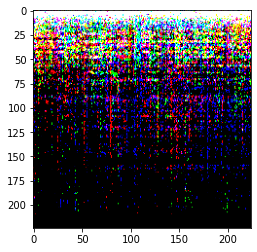

In [21]:
# visualize
plt.figure()
plt.imshow(spec_dataset_full[0][0].permute(1,2,0))
plt.show()

In [22]:
# _=plot_spectrogram(np.array(spec_dataset_full[0][1][0]))
# _=plot_spectrogram(np.array(spec_dataset_full[3][1][0]))

#M3: ML Model Training and Testing 

In [23]:
n_all = len(spec_dataset_full)
n_train = int(0.8 * n_all)
n_test = n_all - n_train
rng = torch.Generator().manual_seed(2048)
dataset_train, dataset_test = torch.utils.data.random_split(spec_dataset_full, [n_train, n_test], rng)

In [24]:
# Batch size of 48 with shuffling
loader_train = torch.utils.data.DataLoader(dataset_train, batch_size = 4, shuffle=True)
loader_test = torch.utils.data.DataLoader(dataset_test, batch_size = 4, shuffle=True)

In [25]:
# for sample, labels in loader_train:
#   print(sample.size())
print(len(loader_train))

875


In [ ]:
# Training (7 estimators)
model.fit(train_loader=loader_train,  # training data
          test_loader=loader_test,    # testing data
          epochs=20)                  # number of training epochs

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth



VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), pad

2021-05-16 02:43:42,501 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_7_ckpt.pth`
2021-05-16 02:44:53,118 - INFO: Epoch: 000 | Validation Acc: 41.781 % | Historical Best: 41.781 %


Estimator: 000 | Epoch: 001 | Batch: 000 | Loss: 3.48895 | Correct: 0/4
Estimator: 000 | Epoch: 001 | Batch: 100 | Loss: 1.96211 | Correct: 1/4
Estimator: 000 | Epoch: 001 | Batch: 200 | Loss: 1.75055 | Correct: 0/4
Estimator: 000 | Epoch: 001 | Batch: 300 | Loss: 1.32710 | Correct: 2/4
Estimator: 000 | Epoch: 001 | Batch: 400 | Loss: 2.95228 | Correct: 1/4
Estimator: 000 | Epoch: 001 | Batch: 500 | Loss: 1.93086 | Correct: 1/4
Estimator: 000 | Epoch: 001 | Batch: 600 | Loss: 1.52001 | Correct: 2/4
Estimator: 000 | Epoch: 001 | Batch: 700 | Loss: 1.00041 | Correct: 3/4
Estimator: 000 | Epoch: 001 | Batch: 800 | Loss: 0.74641 | Correct: 3/4
Estimator: 001 | Epoch: 001 | Batch: 000 | Loss: 1.77899 | Correct: 1/4
Estimator: 001 | Epoch: 001 | Batch: 100 | Loss: 1.94866 | Correct: 1/4
Estimator: 001 | Epoch: 001 | Batch: 200 | Loss: 2.05039 | Correct: 0/4
Estimator: 001 | Epoch: 001 | Batch: 300 | Loss: 1.60115 | Correct: 1/4
Estimator: 001 | Epoch: 001 | Batch: 400 | Loss: 1.38542 | Corre

2021-05-16 02:58:11,386 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_7_ckpt.pth`
2021-05-16 02:59:19,264 - INFO: Epoch: 001 | Validation Acc: 48.630 % | Historical Best: 48.630 %


Estimator: 000 | Epoch: 002 | Batch: 000 | Loss: 1.23161 | Correct: 3/4
Estimator: 000 | Epoch: 002 | Batch: 100 | Loss: 1.17887 | Correct: 2/4
Estimator: 000 | Epoch: 002 | Batch: 200 | Loss: 1.09748 | Correct: 1/4
Estimator: 000 | Epoch: 002 | Batch: 300 | Loss: 1.28072 | Correct: 2/4
Estimator: 000 | Epoch: 002 | Batch: 400 | Loss: 1.43773 | Correct: 2/4
Estimator: 000 | Epoch: 002 | Batch: 500 | Loss: 2.26769 | Correct: 1/4
Estimator: 000 | Epoch: 002 | Batch: 600 | Loss: 0.98070 | Correct: 3/4
Estimator: 000 | Epoch: 002 | Batch: 700 | Loss: 1.14253 | Correct: 3/4
Estimator: 000 | Epoch: 002 | Batch: 800 | Loss: 0.88371 | Correct: 3/4
Estimator: 001 | Epoch: 002 | Batch: 000 | Loss: 0.80453 | Correct: 3/4
Estimator: 001 | Epoch: 002 | Batch: 100 | Loss: 1.83727 | Correct: 1/4
Estimator: 001 | Epoch: 002 | Batch: 200 | Loss: 2.23919 | Correct: 2/4
Estimator: 001 | Epoch: 002 | Batch: 300 | Loss: 1.16851 | Correct: 2/4
Estimator: 001 | Epoch: 002 | Batch: 400 | Loss: 2.57745 | Corre

2021-05-16 03:12:40,262 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_7_ckpt.pth`
2021-05-16 03:13:48,632 - INFO: Epoch: 002 | Validation Acc: 54.909 % | Historical Best: 54.909 %


Estimator: 000 | Epoch: 003 | Batch: 000 | Loss: 1.09995 | Correct: 1/4
Estimator: 000 | Epoch: 003 | Batch: 100 | Loss: 1.63320 | Correct: 1/4
Estimator: 000 | Epoch: 003 | Batch: 200 | Loss: 1.07783 | Correct: 3/4
Estimator: 000 | Epoch: 003 | Batch: 300 | Loss: 2.08676 | Correct: 1/4
Estimator: 000 | Epoch: 003 | Batch: 400 | Loss: 1.66322 | Correct: 0/4
Estimator: 000 | Epoch: 003 | Batch: 500 | Loss: 1.71087 | Correct: 1/4
Estimator: 000 | Epoch: 003 | Batch: 600 | Loss: 1.09757 | Correct: 3/4
Estimator: 000 | Epoch: 003 | Batch: 700 | Loss: 0.69145 | Correct: 4/4
Estimator: 000 | Epoch: 003 | Batch: 800 | Loss: 1.69267 | Correct: 1/4
Estimator: 001 | Epoch: 003 | Batch: 000 | Loss: 0.95673 | Correct: 2/4
Estimator: 001 | Epoch: 003 | Batch: 100 | Loss: 2.07965 | Correct: 1/4
Estimator: 001 | Epoch: 003 | Batch: 200 | Loss: 1.95498 | Correct: 1/4
Estimator: 001 | Epoch: 003 | Batch: 300 | Loss: 1.75418 | Correct: 1/4
Estimator: 001 | Epoch: 003 | Batch: 400 | Loss: 0.54601 | Corre

2021-05-16 03:27:09,528 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_7_ckpt.pth`
2021-05-16 03:28:17,205 - INFO: Epoch: 003 | Validation Acc: 55.936 % | Historical Best: 55.936 %


Estimator: 000 | Epoch: 004 | Batch: 000 | Loss: 1.45926 | Correct: 3/4
Estimator: 000 | Epoch: 004 | Batch: 100 | Loss: 1.42701 | Correct: 2/4
Estimator: 000 | Epoch: 004 | Batch: 200 | Loss: 1.35436 | Correct: 1/4
Estimator: 000 | Epoch: 004 | Batch: 300 | Loss: 0.95036 | Correct: 3/4
Estimator: 000 | Epoch: 004 | Batch: 400 | Loss: 2.14127 | Correct: 2/4
Estimator: 000 | Epoch: 004 | Batch: 500 | Loss: 1.76380 | Correct: 1/4
Estimator: 000 | Epoch: 004 | Batch: 600 | Loss: 1.40780 | Correct: 2/4
Estimator: 000 | Epoch: 004 | Batch: 700 | Loss: 1.43510 | Correct: 2/4
Estimator: 000 | Epoch: 004 | Batch: 800 | Loss: 0.60692 | Correct: 3/4
Estimator: 001 | Epoch: 004 | Batch: 000 | Loss: 1.04148 | Correct: 3/4
Estimator: 001 | Epoch: 004 | Batch: 100 | Loss: 1.74621 | Correct: 1/4
Estimator: 001 | Epoch: 004 | Batch: 200 | Loss: 1.41913 | Correct: 1/4
Estimator: 001 | Epoch: 004 | Batch: 300 | Loss: 1.30610 | Correct: 1/4
Estimator: 001 | Epoch: 004 | Batch: 400 | Loss: 0.78998 | Corre

2021-05-16 03:41:42,391 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_7_ckpt.pth`
2021-05-16 03:42:48,371 - INFO: Epoch: 004 | Validation Acc: 59.018 % | Historical Best: 59.018 %


Estimator: 000 | Epoch: 005 | Batch: 000 | Loss: 0.38498 | Correct: 4/4
Estimator: 000 | Epoch: 005 | Batch: 100 | Loss: 1.15368 | Correct: 2/4
Estimator: 000 | Epoch: 005 | Batch: 200 | Loss: 1.67514 | Correct: 2/4
Estimator: 000 | Epoch: 005 | Batch: 300 | Loss: 0.60395 | Correct: 4/4
Estimator: 000 | Epoch: 005 | Batch: 400 | Loss: 1.09213 | Correct: 1/4
Estimator: 000 | Epoch: 005 | Batch: 500 | Loss: 0.24162 | Correct: 4/4
Estimator: 000 | Epoch: 005 | Batch: 600 | Loss: 0.79620 | Correct: 3/4
Estimator: 000 | Epoch: 005 | Batch: 700 | Loss: 0.80774 | Correct: 3/4
Estimator: 000 | Epoch: 005 | Batch: 800 | Loss: 0.50364 | Correct: 3/4
Estimator: 001 | Epoch: 005 | Batch: 000 | Loss: 0.46258 | Correct: 3/4
Estimator: 001 | Epoch: 005 | Batch: 100 | Loss: 1.57937 | Correct: 0/4
Estimator: 001 | Epoch: 005 | Batch: 200 | Loss: 0.45454 | Correct: 4/4
Estimator: 001 | Epoch: 005 | Batch: 300 | Loss: 0.37786 | Correct: 4/4
Estimator: 001 | Epoch: 005 | Batch: 400 | Loss: 1.02823 | Corre

2021-05-16 03:56:16,394 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_7_ckpt.pth`
2021-05-16 03:57:23,506 - INFO: Epoch: 005 | Validation Acc: 61.530 % | Historical Best: 61.530 %


Estimator: 000 | Epoch: 006 | Batch: 000 | Loss: 0.65342 | Correct: 3/4
Estimator: 000 | Epoch: 006 | Batch: 100 | Loss: 0.59010 | Correct: 3/4
Estimator: 000 | Epoch: 006 | Batch: 200 | Loss: 0.75914 | Correct: 2/4
Estimator: 000 | Epoch: 006 | Batch: 300 | Loss: 0.15787 | Correct: 4/4
Estimator: 000 | Epoch: 006 | Batch: 400 | Loss: 0.09976 | Correct: 4/4
Estimator: 000 | Epoch: 006 | Batch: 500 | Loss: 1.24226 | Correct: 2/4
Estimator: 000 | Epoch: 006 | Batch: 600 | Loss: 0.43583 | Correct: 3/4
Estimator: 000 | Epoch: 006 | Batch: 700 | Loss: 0.67249 | Correct: 3/4
Estimator: 000 | Epoch: 006 | Batch: 800 | Loss: 0.32363 | Correct: 4/4
Estimator: 001 | Epoch: 006 | Batch: 000 | Loss: 1.00164 | Correct: 2/4
Estimator: 001 | Epoch: 006 | Batch: 100 | Loss: 1.04467 | Correct: 3/4
Estimator: 001 | Epoch: 006 | Batch: 200 | Loss: 0.73599 | Correct: 3/4
Estimator: 001 | Epoch: 006 | Batch: 300 | Loss: 0.35564 | Correct: 4/4
Estimator: 001 | Epoch: 006 | Batch: 400 | Loss: 0.68443 | Corre

2021-05-16 04:10:50,237 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_7_ckpt.pth`
2021-05-16 04:11:58,840 - INFO: Epoch: 006 | Validation Acc: 62.329 % | Historical Best: 62.329 %


Estimator: 000 | Epoch: 007 | Batch: 000 | Loss: 0.62265 | Correct: 3/4
Estimator: 000 | Epoch: 007 | Batch: 100 | Loss: 0.26040 | Correct: 4/4
Estimator: 000 | Epoch: 007 | Batch: 200 | Loss: 0.73973 | Correct: 3/4
Estimator: 000 | Epoch: 007 | Batch: 300 | Loss: 1.85229 | Correct: 1/4
Estimator: 000 | Epoch: 007 | Batch: 400 | Loss: 0.21527 | Correct: 4/4
Estimator: 000 | Epoch: 007 | Batch: 500 | Loss: 1.02402 | Correct: 3/4
Estimator: 000 | Epoch: 007 | Batch: 600 | Loss: 1.48422 | Correct: 1/4
Estimator: 000 | Epoch: 007 | Batch: 700 | Loss: 0.79488 | Correct: 3/4
Estimator: 000 | Epoch: 007 | Batch: 800 | Loss: 0.52839 | Correct: 3/4
Estimator: 001 | Epoch: 007 | Batch: 000 | Loss: 1.18865 | Correct: 1/4
Estimator: 001 | Epoch: 007 | Batch: 100 | Loss: 1.20242 | Correct: 2/4
Estimator: 001 | Epoch: 007 | Batch: 200 | Loss: 0.53042 | Correct: 3/4
Estimator: 001 | Epoch: 007 | Batch: 300 | Loss: 0.32476 | Correct: 4/4
Estimator: 001 | Epoch: 007 | Batch: 400 | Loss: 0.09476 | Corre

2021-05-16 04:25:22,121 - INFO: Epoch: 007 | Validation Acc: 61.644 % | Historical Best: 62.329 %


Estimator: 000 | Epoch: 008 | Batch: 000 | Loss: 0.54017 | Correct: 4/4
Estimator: 000 | Epoch: 008 | Batch: 100 | Loss: 0.63259 | Correct: 3/4
Estimator: 000 | Epoch: 008 | Batch: 200 | Loss: 0.94650 | Correct: 3/4
Estimator: 000 | Epoch: 008 | Batch: 300 | Loss: 1.37003 | Correct: 2/4
Estimator: 000 | Epoch: 008 | Batch: 400 | Loss: 0.42188 | Correct: 4/4
Estimator: 000 | Epoch: 008 | Batch: 500 | Loss: 0.46838 | Correct: 4/4
Estimator: 000 | Epoch: 008 | Batch: 600 | Loss: 0.20029 | Correct: 3/4
Estimator: 000 | Epoch: 008 | Batch: 700 | Loss: 0.33375 | Correct: 4/4
Estimator: 000 | Epoch: 008 | Batch: 800 | Loss: 0.11052 | Correct: 4/4
Estimator: 001 | Epoch: 008 | Batch: 000 | Loss: 1.39133 | Correct: 2/4
Estimator: 001 | Epoch: 008 | Batch: 100 | Loss: 0.88587 | Correct: 3/4
Estimator: 001 | Epoch: 008 | Batch: 200 | Loss: 0.25830 | Correct: 4/4
Estimator: 001 | Epoch: 008 | Batch: 300 | Loss: 0.13768 | Correct: 4/4
Estimator: 001 | Epoch: 008 | Batch: 400 | Loss: 0.43081 | Corre

2021-05-16 04:38:42,448 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_7_ckpt.pth`
2021-05-16 04:39:49,586 - INFO: Epoch: 008 | Validation Acc: 63.128 % | Historical Best: 63.128 %


Estimator: 000 | Epoch: 009 | Batch: 000 | Loss: 0.48619 | Correct: 3/4
Estimator: 000 | Epoch: 009 | Batch: 100 | Loss: 0.58244 | Correct: 3/4
Estimator: 000 | Epoch: 009 | Batch: 200 | Loss: 0.20257 | Correct: 4/4
Estimator: 000 | Epoch: 009 | Batch: 300 | Loss: 0.96624 | Correct: 3/4
Estimator: 000 | Epoch: 009 | Batch: 400 | Loss: 0.93530 | Correct: 2/4
Estimator: 000 | Epoch: 009 | Batch: 500 | Loss: 0.86804 | Correct: 2/4
Estimator: 000 | Epoch: 009 | Batch: 600 | Loss: 0.58153 | Correct: 4/4
Estimator: 000 | Epoch: 009 | Batch: 700 | Loss: 0.60619 | Correct: 2/4
Estimator: 000 | Epoch: 009 | Batch: 800 | Loss: 0.76632 | Correct: 2/4
Estimator: 001 | Epoch: 009 | Batch: 000 | Loss: 0.26213 | Correct: 4/4
Estimator: 001 | Epoch: 009 | Batch: 100 | Loss: 0.83314 | Correct: 2/4
Estimator: 001 | Epoch: 009 | Batch: 200 | Loss: 0.20981 | Correct: 4/4
Estimator: 001 | Epoch: 009 | Batch: 300 | Loss: 0.53221 | Correct: 4/4
Estimator: 001 | Epoch: 009 | Batch: 400 | Loss: 1.01902 | Corre

2021-05-16 04:53:14,098 - INFO: Epoch: 009 | Validation Acc: 62.671 % | Historical Best: 63.128 %


Estimator: 000 | Epoch: 010 | Batch: 000 | Loss: 1.01967 | Correct: 3/4
Estimator: 000 | Epoch: 010 | Batch: 100 | Loss: 0.72285 | Correct: 3/4
Estimator: 000 | Epoch: 010 | Batch: 200 | Loss: 0.88056 | Correct: 2/4
Estimator: 000 | Epoch: 010 | Batch: 300 | Loss: 0.19120 | Correct: 4/4
Estimator: 000 | Epoch: 010 | Batch: 400 | Loss: 0.26743 | Correct: 4/4
Estimator: 000 | Epoch: 010 | Batch: 500 | Loss: 0.42696 | Correct: 4/4
Estimator: 000 | Epoch: 010 | Batch: 600 | Loss: 0.09316 | Correct: 4/4
Estimator: 000 | Epoch: 010 | Batch: 700 | Loss: 0.33284 | Correct: 4/4
Estimator: 000 | Epoch: 010 | Batch: 800 | Loss: 0.99322 | Correct: 3/4
Estimator: 001 | Epoch: 010 | Batch: 000 | Loss: 1.60276 | Correct: 2/4
Estimator: 001 | Epoch: 010 | Batch: 100 | Loss: 0.83065 | Correct: 3/4
Estimator: 001 | Epoch: 010 | Batch: 200 | Loss: 0.57878 | Correct: 4/4
Estimator: 001 | Epoch: 010 | Batch: 300 | Loss: 0.30952 | Correct: 4/4
Estimator: 001 | Epoch: 010 | Batch: 400 | Loss: 1.06957 | Corre

2021-05-16 05:06:35,101 - INFO: Epoch: 010 | Validation Acc: 62.785 % | Historical Best: 63.128 %


Estimator: 000 | Epoch: 011 | Batch: 000 | Loss: 0.10509 | Correct: 4/4
Estimator: 000 | Epoch: 011 | Batch: 100 | Loss: 0.18582 | Correct: 4/4
Estimator: 000 | Epoch: 011 | Batch: 200 | Loss: 0.83405 | Correct: 3/4
Estimator: 000 | Epoch: 011 | Batch: 300 | Loss: 0.19415 | Correct: 4/4
Estimator: 000 | Epoch: 011 | Batch: 400 | Loss: 1.33201 | Correct: 2/4
Estimator: 000 | Epoch: 011 | Batch: 500 | Loss: 0.26946 | Correct: 4/4
Estimator: 000 | Epoch: 011 | Batch: 600 | Loss: 1.00730 | Correct: 3/4
Estimator: 000 | Epoch: 011 | Batch: 700 | Loss: 0.38212 | Correct: 4/4
Estimator: 000 | Epoch: 011 | Batch: 800 | Loss: 0.64131 | Correct: 3/4
Estimator: 001 | Epoch: 011 | Batch: 000 | Loss: 0.15095 | Correct: 4/4
Estimator: 001 | Epoch: 011 | Batch: 100 | Loss: 0.31087 | Correct: 4/4
Estimator: 001 | Epoch: 011 | Batch: 200 | Loss: 0.52725 | Correct: 3/4
Estimator: 001 | Epoch: 011 | Batch: 300 | Loss: 0.39840 | Correct: 4/4
Estimator: 001 | Epoch: 011 | Batch: 400 | Loss: 0.76706 | Corre

2021-05-16 05:19:56,000 - INFO: Epoch: 011 | Validation Acc: 63.014 % | Historical Best: 63.128 %


Estimator: 000 | Epoch: 012 | Batch: 000 | Loss: 0.65680 | Correct: 2/4
Estimator: 000 | Epoch: 012 | Batch: 100 | Loss: 0.37693 | Correct: 4/4
Estimator: 000 | Epoch: 012 | Batch: 200 | Loss: 0.47624 | Correct: 3/4
Estimator: 000 | Epoch: 012 | Batch: 300 | Loss: 0.04429 | Correct: 4/4
Estimator: 000 | Epoch: 012 | Batch: 400 | Loss: 0.84389 | Correct: 3/4
Estimator: 000 | Epoch: 012 | Batch: 500 | Loss: 0.21646 | Correct: 4/4
Estimator: 000 | Epoch: 012 | Batch: 600 | Loss: 0.85361 | Correct: 3/4
Estimator: 000 | Epoch: 012 | Batch: 700 | Loss: 0.36578 | Correct: 4/4
Estimator: 000 | Epoch: 012 | Batch: 800 | Loss: 0.26200 | Correct: 4/4
Estimator: 001 | Epoch: 012 | Batch: 000 | Loss: 0.17738 | Correct: 4/4
Estimator: 001 | Epoch: 012 | Batch: 100 | Loss: 0.28743 | Correct: 4/4
Estimator: 001 | Epoch: 012 | Batch: 200 | Loss: 0.09710 | Correct: 4/4
Estimator: 001 | Epoch: 012 | Batch: 300 | Loss: 0.44833 | Correct: 3/4
Estimator: 001 | Epoch: 012 | Batch: 400 | Loss: 0.15629 | Corre

2021-05-16 05:33:17,180 - INFO: Epoch: 012 | Validation Acc: 62.785 % | Historical Best: 63.128 %


Estimator: 000 | Epoch: 013 | Batch: 000 | Loss: 0.30286 | Correct: 4/4
Estimator: 000 | Epoch: 013 | Batch: 100 | Loss: 0.05522 | Correct: 4/4
Estimator: 000 | Epoch: 013 | Batch: 200 | Loss: 0.03773 | Correct: 4/4
Estimator: 000 | Epoch: 013 | Batch: 300 | Loss: 0.11316 | Correct: 4/4
Estimator: 000 | Epoch: 013 | Batch: 400 | Loss: 0.52510 | Correct: 3/4
Estimator: 000 | Epoch: 013 | Batch: 500 | Loss: 0.14029 | Correct: 4/4
Estimator: 000 | Epoch: 013 | Batch: 600 | Loss: 1.14008 | Correct: 3/4
Estimator: 000 | Epoch: 013 | Batch: 700 | Loss: 0.65279 | Correct: 3/4
Estimator: 000 | Epoch: 013 | Batch: 800 | Loss: 0.69683 | Correct: 3/4
Estimator: 001 | Epoch: 013 | Batch: 000 | Loss: 0.39792 | Correct: 3/4
Estimator: 001 | Epoch: 013 | Batch: 100 | Loss: 0.22177 | Correct: 4/4
Estimator: 001 | Epoch: 013 | Batch: 200 | Loss: 0.09252 | Correct: 4/4
Estimator: 001 | Epoch: 013 | Batch: 300 | Loss: 0.43607 | Correct: 3/4
Estimator: 001 | Epoch: 013 | Batch: 400 | Loss: 0.12211 | Corre

2021-05-16 05:46:38,093 - INFO: Epoch: 013 | Validation Acc: 63.014 % | Historical Best: 63.128 %


Estimator: 000 | Epoch: 014 | Batch: 000 | Loss: 0.41504 | Correct: 4/4
Estimator: 000 | Epoch: 014 | Batch: 100 | Loss: 0.52863 | Correct: 4/4
Estimator: 000 | Epoch: 014 | Batch: 200 | Loss: 0.39189 | Correct: 3/4
Estimator: 000 | Epoch: 014 | Batch: 300 | Loss: 0.11976 | Correct: 4/4
Estimator: 000 | Epoch: 014 | Batch: 400 | Loss: 0.27946 | Correct: 4/4
Estimator: 000 | Epoch: 014 | Batch: 500 | Loss: 0.03215 | Correct: 4/4
Estimator: 000 | Epoch: 014 | Batch: 600 | Loss: 0.36282 | Correct: 3/4
Estimator: 000 | Epoch: 014 | Batch: 700 | Loss: 0.47810 | Correct: 3/4
Estimator: 000 | Epoch: 014 | Batch: 800 | Loss: 0.25007 | Correct: 4/4
Estimator: 001 | Epoch: 014 | Batch: 000 | Loss: 1.71582 | Correct: 3/4
Estimator: 001 | Epoch: 014 | Batch: 100 | Loss: 0.53935 | Correct: 3/4
Estimator: 001 | Epoch: 014 | Batch: 200 | Loss: 1.13013 | Correct: 2/4
Estimator: 001 | Epoch: 014 | Batch: 300 | Loss: 0.48832 | Correct: 3/4
Estimator: 001 | Epoch: 014 | Batch: 400 | Loss: 0.08825 | Corre

2021-05-16 05:59:58,810 - INFO: Epoch: 014 | Validation Acc: 62.785 % | Historical Best: 63.128 %


Estimator: 000 | Epoch: 015 | Batch: 000 | Loss: 0.21369 | Correct: 4/4
Estimator: 000 | Epoch: 015 | Batch: 100 | Loss: 0.22683 | Correct: 3/4
Estimator: 000 | Epoch: 015 | Batch: 200 | Loss: 1.09913 | Correct: 3/4
Estimator: 000 | Epoch: 015 | Batch: 300 | Loss: 0.00332 | Correct: 4/4
Estimator: 000 | Epoch: 015 | Batch: 400 | Loss: 0.44053 | Correct: 3/4
Estimator: 000 | Epoch: 015 | Batch: 500 | Loss: 0.05788 | Correct: 4/4
Estimator: 000 | Epoch: 015 | Batch: 600 | Loss: 0.51048 | Correct: 3/4
Estimator: 000 | Epoch: 015 | Batch: 700 | Loss: 0.03209 | Correct: 4/4
Estimator: 000 | Epoch: 015 | Batch: 800 | Loss: 0.52482 | Correct: 4/4
Estimator: 001 | Epoch: 015 | Batch: 000 | Loss: 0.61194 | Correct: 3/4
Estimator: 001 | Epoch: 015 | Batch: 100 | Loss: 0.11650 | Correct: 4/4
Estimator: 001 | Epoch: 015 | Batch: 200 | Loss: 1.51375 | Correct: 1/4
Estimator: 001 | Epoch: 015 | Batch: 300 | Loss: 0.04688 | Correct: 4/4
Estimator: 001 | Epoch: 015 | Batch: 400 | Loss: 1.33381 | Corre

2021-05-16 06:13:19,147 - INFO: Epoch: 015 | Validation Acc: 63.014 % | Historical Best: 63.128 %


Estimator: 000 | Epoch: 016 | Batch: 000 | Loss: 0.22657 | Correct: 4/4
Estimator: 000 | Epoch: 016 | Batch: 100 | Loss: 0.32516 | Correct: 4/4
Estimator: 000 | Epoch: 016 | Batch: 200 | Loss: 1.16788 | Correct: 2/4
Estimator: 000 | Epoch: 016 | Batch: 300 | Loss: 0.86680 | Correct: 2/4
Estimator: 000 | Epoch: 016 | Batch: 400 | Loss: 0.32186 | Correct: 3/4
Estimator: 000 | Epoch: 016 | Batch: 500 | Loss: 0.24247 | Correct: 3/4
Estimator: 000 | Epoch: 016 | Batch: 600 | Loss: 1.53053 | Correct: 2/4
Estimator: 000 | Epoch: 016 | Batch: 700 | Loss: 0.44736 | Correct: 3/4
Estimator: 000 | Epoch: 016 | Batch: 800 | Loss: 0.80687 | Correct: 3/4
Estimator: 001 | Epoch: 016 | Batch: 000 | Loss: 0.19489 | Correct: 4/4
Estimator: 001 | Epoch: 016 | Batch: 100 | Loss: 0.47907 | Correct: 3/4
Estimator: 001 | Epoch: 016 | Batch: 200 | Loss: 0.14651 | Correct: 4/4
Estimator: 001 | Epoch: 016 | Batch: 300 | Loss: 0.12081 | Correct: 4/4
Estimator: 001 | Epoch: 016 | Batch: 400 | Loss: 0.11179 | Corre

In [18]:
# # Training (3 estimators)
# model.fit(train_loader=loader_train,  # training data
#           test_loader=loader_test,    # testing data
#           epochs=20)                  # number of training epochs

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

2021-05-16 00:05:26,219 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_3_ckpt.pth`
2021-05-16 00:05:35,299 - INFO: Epoch: 000 | Validation Acc: 39.612 % | Historical Best: 39.612 %


Estimator: 000 | Epoch: 001 | Batch: 000 | Loss: 1.44545 | Correct: 20/48
Estimator: 001 | Epoch: 001 | Batch: 000 | Loss: 1.67803 | Correct: 19/48
Estimator: 002 | Epoch: 001 | Batch: 000 | Loss: 1.88752 | Correct: 11/48


2021-05-16 00:08:53,775 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_3_ckpt.pth`
2021-05-16 00:09:04,389 - INFO: Epoch: 001 | Validation Acc: 48.630 % | Historical Best: 48.630 %


Estimator: 000 | Epoch: 002 | Batch: 000 | Loss: 1.53997 | Correct: 20/48
Estimator: 001 | Epoch: 002 | Batch: 000 | Loss: 1.55655 | Correct: 18/48
Estimator: 002 | Epoch: 002 | Batch: 000 | Loss: 1.43136 | Correct: 22/48


2021-05-16 00:12:15,381 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_3_ckpt.pth`
2021-05-16 00:12:25,209 - INFO: Epoch: 002 | Validation Acc: 52.626 % | Historical Best: 52.626 %


Estimator: 000 | Epoch: 003 | Batch: 000 | Loss: 1.42781 | Correct: 21/48
Estimator: 001 | Epoch: 003 | Batch: 000 | Loss: 1.46529 | Correct: 24/48
Estimator: 002 | Epoch: 003 | Batch: 000 | Loss: 1.45119 | Correct: 21/48


2021-05-16 00:15:37,297 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_3_ckpt.pth`
2021-05-16 00:15:47,149 - INFO: Epoch: 003 | Validation Acc: 53.196 % | Historical Best: 53.196 %


Estimator: 000 | Epoch: 004 | Batch: 000 | Loss: 1.24459 | Correct: 28/48
Estimator: 001 | Epoch: 004 | Batch: 000 | Loss: 0.76167 | Correct: 33/48
Estimator: 002 | Epoch: 004 | Batch: 000 | Loss: 1.25711 | Correct: 24/48


2021-05-16 00:18:59,487 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_3_ckpt.pth`
2021-05-16 00:19:09,651 - INFO: Epoch: 004 | Validation Acc: 57.534 % | Historical Best: 57.534 %


Estimator: 000 | Epoch: 005 | Batch: 000 | Loss: 1.13877 | Correct: 29/48
Estimator: 001 | Epoch: 005 | Batch: 000 | Loss: 0.95056 | Correct: 32/48
Estimator: 002 | Epoch: 005 | Batch: 000 | Loss: 0.99299 | Correct: 28/48


2021-05-16 00:22:20,519 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_3_ckpt.pth`
2021-05-16 00:22:30,937 - INFO: Epoch: 005 | Validation Acc: 59.475 % | Historical Best: 59.475 %


Estimator: 000 | Epoch: 006 | Batch: 000 | Loss: 0.88024 | Correct: 30/48
Estimator: 001 | Epoch: 006 | Batch: 000 | Loss: 0.99045 | Correct: 31/48
Estimator: 002 | Epoch: 006 | Batch: 000 | Loss: 0.97783 | Correct: 30/48


2021-05-16 00:25:44,957 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_3_ckpt.pth`
2021-05-16 00:25:54,960 - INFO: Epoch: 006 | Validation Acc: 60.388 % | Historical Best: 60.388 %


Estimator: 000 | Epoch: 007 | Batch: 000 | Loss: 1.10475 | Correct: 28/48
Estimator: 001 | Epoch: 007 | Batch: 000 | Loss: 0.81315 | Correct: 34/48
Estimator: 002 | Epoch: 007 | Batch: 000 | Loss: 1.09638 | Correct: 30/48


2021-05-16 00:29:06,334 - INFO: Epoch: 007 | Validation Acc: 60.274 % | Historical Best: 60.388 %


Estimator: 000 | Epoch: 008 | Batch: 000 | Loss: 1.01094 | Correct: 25/48
Estimator: 001 | Epoch: 008 | Batch: 000 | Loss: 0.93910 | Correct: 33/48
Estimator: 002 | Epoch: 008 | Batch: 000 | Loss: 0.80697 | Correct: 33/48


2021-05-16 00:32:17,392 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_3_ckpt.pth`
2021-05-16 00:32:27,101 - INFO: Epoch: 008 | Validation Acc: 60.502 % | Historical Best: 60.502 %


Estimator: 000 | Epoch: 009 | Batch: 000 | Loss: 1.17884 | Correct: 30/48
Estimator: 001 | Epoch: 009 | Batch: 000 | Loss: 1.21222 | Correct: 23/48
Estimator: 002 | Epoch: 009 | Batch: 000 | Loss: 0.76686 | Correct: 34/48


2021-05-16 00:35:38,376 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_3_ckpt.pth`
2021-05-16 00:35:48,120 - INFO: Epoch: 009 | Validation Acc: 61.301 % | Historical Best: 61.301 %


Estimator: 000 | Epoch: 010 | Batch: 000 | Loss: 1.30125 | Correct: 24/48
Estimator: 001 | Epoch: 010 | Batch: 000 | Loss: 0.89951 | Correct: 34/48
Estimator: 002 | Epoch: 010 | Batch: 000 | Loss: 0.86345 | Correct: 33/48


2021-05-16 00:39:00,008 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_3_ckpt.pth`
2021-05-16 00:39:10,796 - INFO: Epoch: 010 | Validation Acc: 62.100 % | Historical Best: 62.100 %


Estimator: 000 | Epoch: 011 | Batch: 000 | Loss: 1.04640 | Correct: 31/48
Estimator: 001 | Epoch: 011 | Batch: 000 | Loss: 0.81146 | Correct: 31/48
Estimator: 002 | Epoch: 011 | Batch: 000 | Loss: 0.78137 | Correct: 34/48


2021-05-16 00:42:26,937 - INFO: Epoch: 011 | Validation Acc: 62.100 % | Historical Best: 62.100 %


Estimator: 000 | Epoch: 012 | Batch: 000 | Loss: 0.95715 | Correct: 31/48
Estimator: 001 | Epoch: 012 | Batch: 000 | Loss: 0.73402 | Correct: 32/48
Estimator: 002 | Epoch: 012 | Batch: 000 | Loss: 0.83045 | Correct: 35/48


2021-05-16 00:45:37,522 - INFO: Epoch: 012 | Validation Acc: 61.872 % | Historical Best: 62.100 %


Estimator: 000 | Epoch: 013 | Batch: 000 | Loss: 0.74964 | Correct: 32/48
Estimator: 001 | Epoch: 013 | Batch: 000 | Loss: 0.72000 | Correct: 38/48
Estimator: 002 | Epoch: 013 | Batch: 000 | Loss: 0.77649 | Correct: 34/48


2021-05-16 00:48:48,084 - INFO: Epoch: 013 | Validation Acc: 62.100 % | Historical Best: 62.100 %


Estimator: 000 | Epoch: 014 | Batch: 000 | Loss: 1.02670 | Correct: 29/48
Estimator: 001 | Epoch: 014 | Batch: 000 | Loss: 0.92004 | Correct: 28/48
Estimator: 002 | Epoch: 014 | Batch: 000 | Loss: 0.95947 | Correct: 29/48


2021-05-16 00:51:58,989 - INFO: Epoch: 014 | Validation Acc: 61.986 % | Historical Best: 62.100 %


Estimator: 000 | Epoch: 015 | Batch: 000 | Loss: 0.91074 | Correct: 30/48
Estimator: 001 | Epoch: 015 | Batch: 000 | Loss: 1.05887 | Correct: 27/48
Estimator: 002 | Epoch: 015 | Batch: 000 | Loss: 0.92307 | Correct: 29/48


2021-05-16 00:55:09,850 - INFO: Saving the model to `./VotingClassifier_GenreClassifier_3_ckpt.pth`
2021-05-16 00:55:19,597 - INFO: Epoch: 015 | Validation Acc: 62.215 % | Historical Best: 62.215 %


Estimator: 000 | Epoch: 016 | Batch: 000 | Loss: 0.88313 | Correct: 28/48
Estimator: 001 | Epoch: 016 | Batch: 000 | Loss: 0.98518 | Correct: 28/48
Estimator: 002 | Epoch: 016 | Batch: 000 | Loss: 0.64068 | Correct: 35/48


2021-05-16 00:58:32,210 - INFO: Epoch: 016 | Validation Acc: 62.215 % | Historical Best: 62.215 %


Estimator: 000 | Epoch: 017 | Batch: 000 | Loss: 0.55266 | Correct: 39/48
Estimator: 001 | Epoch: 017 | Batch: 000 | Loss: 0.85755 | Correct: 33/48
Estimator: 002 | Epoch: 017 | Batch: 000 | Loss: 0.89652 | Correct: 31/48


2021-05-16 01:01:43,336 - INFO: Epoch: 017 | Validation Acc: 62.100 % | Historical Best: 62.215 %


Estimator: 000 | Epoch: 018 | Batch: 000 | Loss: 1.06832 | Correct: 26/48
Estimator: 001 | Epoch: 018 | Batch: 000 | Loss: 0.92668 | Correct: 32/48
Estimator: 002 | Epoch: 018 | Batch: 000 | Loss: 0.85896 | Correct: 37/48


2021-05-16 01:04:54,268 - INFO: Epoch: 018 | Validation Acc: 62.215 % | Historical Best: 62.215 %


Estimator: 000 | Epoch: 019 | Batch: 000 | Loss: 1.11925 | Correct: 27/48
Estimator: 001 | Epoch: 019 | Batch: 000 | Loss: 0.97364 | Correct: 31/48
Estimator: 002 | Epoch: 019 | Batch: 000 | Loss: 0.72545 | Correct: 37/48


2021-05-16 01:08:05,377 - INFO: Epoch: 019 | Validation Acc: 62.100 % | Historical Best: 62.215 %


In [ ]:
# Commented out cause we have our own model
# model = models.resnet18(pretrained=True)

In [ ]:
# model.classifier[6]

Linear(in_features=4096, out_features=8, bias=True)

In [ ]:
# # Ensure hardware acceleration: GPU is enabled
# device = torch.device('cuda:0')
# model = model.to(device)

In [ ]:
# # ASSIGNMENT 2 CODE, UNMODIFIED

# # # specifying a loss function
# # criterion = nn.CrossEntropyLoss()

# # # Function to evaluate current model on the test set:
# # # a - copies samples and labels to GPU
# # # b - apply model to make predictions
# # # c - compute the loss between those predictions and the correct labels
# # # Notes above based on "transfer_learning.ipynb"

# # def run_test(model):
# #   nsamples_test = len(dataset_test)
# #   loss, correct = 0, 0
# #   model.eval()
# #   with torch.no_grad():
# #     for samples, labels in loader_test:
# #       # a
# #       samples = samples.to(device)
# #       labels = labels.to(device)
# #       # b
# #       outs = model(samples)
# #       # c
# #       loss += criterion(outs, labels)
# #       # computing output accuracy
# #       _, preds = torch.max(outs.detach(), 1)
# #       correct_mask = preds == labels
# #       correct += correct_mask.sum(0).item()
# #   return loss /  nsamples_test, correct / nsamples_test

# # # model.eval() and torch.no_grad() put the model in testing mode (some layer
# # # behave differently while testing compared to training. )
# ################################################################################

# criterion = nn.CrossEntropyLoss()

# def run_test(model):
#     nsamples_test = len(dataset_test)
#     loss, correct = 0, 0
#     model.eval()
#     with torch.no_grad():
#         for labels, sample in loader_test:
#             labels = labels.to(device)
#             # print(labels.size())
#             sample = sample.to(device)
#             # print(sample.size())
#             outs = model(sample)

#             loss += criterion(outs, labels)

#             _, preds = torch.max(outs.detach(), 1)
#             correct_mask = preds == labels
#             correct += correct_mask.sum(0).item()
#     return loss / nsamples_test, correct / nsamples_test

In [ ]:
# # Using the parameters from the class notebook (-0.1 learning rate / 5 epochs)
# optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.7)
# scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.15)

In [ ]:
# # ASSIGNMENT 2 CODE, UNMODIFIED

# # # function to train model
# # # a - copies samples and labels to GPU
# # # b - apply model to make predictions
# # # c - compute the loss between those predictions and the correct labels
# # # Notes above based on "transfer_learning.ipynb"
# # def run_train(model, opt, sched):
# #   nsamples_train = len(dataset_train)
# #   loss_sofar, correct_sofar = 0, 0
# #   model.train()
# #   with torch.enable_grad():
# #     for samples, labels in loader_train:
# #       # a 
# #       samples = samples.to(device)
# #       labels = labels.to(device)
# #       # b
# #       opt.zero_grad()             # model adjustment
# #       outs = model(samples)
# #       # c
# #       _, preds = torch.max(outs.detach(), 1)
# #       loss = criterion(outs, labels)
# #       loss.backward()             # model adjustment
# #       opt.step()                  # model adjustment
# #       # computing output accuracy
# #       loss_sofar += loss.item() * samples.size(0)
# #       correct_sofar += torch.sum(preds == labels.detach())
# #   sched.step()
# #   return loss_sofar / nsamples_train, correct_sofar / nsamples_train
# ################################################################################

# def run_train(model, opt, sched):
#     nsamples_train = len(dataset_train)
#     loss_sofar, correct_sofar = 0, 0
#     model.train()
#     with torch.enable_grad():
#         for labels, sample in loader_train:
#             labels = torch.tensor(labels).to(device)
#             sample = sample.to(device)
#             opt.zero_grad()
#             outs = model(sample)
#             _, preds = torch.max(outs.detach(), 1)
#             loss = criterion(outs, labels)
#             loss.backward()
#             opt.step()
#             loss_sofar += loss.item() * labels.size(0)
#             correct_sofar += torch.sum(preds == labels.detach())
#     sched.step()
#     return loss_sofar / nsamples_train, correct_sofar / nsamples_train

In [ ]:
# def run_all(model, optimizer, scheduler, n_epochs):
#     for epoch in range(n_epochs):
#         loss_train, acc_train = run_train(model, optimizer, scheduler)
#         loss_test, acc_test = run_test(model)
#         print(f"epoch {epoch}: train loss {loss_train:.4f} acc {acc_train:.4f}, test loss {loss_test:.4f} acc {acc_test:.4f}")

In [ ]:
#run_test(model)

(tensor(0.1007, device='cuda:0'), 0.15789473684210525)

In [ ]:
# run_all(model, optimizer, scheduler, 20) # Folk, Jazz, Blues, Country, Electronic excluded. 228 samples per genre 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:38: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


epoch 0: train loss 1.2386 acc 0.4278, test loss 0.0213 acc 0.5839
epoch 1: train loss 0.9252 acc 0.5777, test loss 0.0206 acc 0.6131
epoch 2: train loss 0.8576 acc 0.6088, test loss 0.0200 acc 0.6204
epoch 3: train loss 0.7599 acc 0.6618, test loss 0.0210 acc 0.5912
epoch 4: train loss 0.6712 acc 0.7276, test loss 0.0179 acc 0.6861
epoch 5: train loss 0.5414 acc 0.7952, test loss 0.0185 acc 0.6715
epoch 6: train loss 0.5208 acc 0.7879, test loss 0.0178 acc 0.6788
epoch 7: train loss 0.4877 acc 0.8318, test loss 0.0182 acc 0.6788
epoch 8: train loss 0.4942 acc 0.8245, test loss 0.0183 acc 0.6934
epoch 9: train loss 0.4379 acc 0.8428, test loss 0.0184 acc 0.7007
epoch 10: train loss 0.4368 acc 0.8227, test loss 0.0187 acc 0.7007
epoch 11: train loss 0.4039 acc 0.8702, test loss 0.0186 acc 0.6934
epoch 12: train loss 0.4186 acc 0.8483, test loss 0.0182 acc 0.6934
epoch 13: train loss 0.4229 acc 0.8373, test loss 0.0183 acc 0.6934
epoch 14: train loss 0.4075 acc 0.8519, test loss 0.0184 a

In [ ]:
# run_all(model, optimizer, scheduler, 20) # Folk, Jazz, Blues and Country excluded. 197 samples per genre 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:38: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


epoch 0: train loss 1.5085 acc 0.3206, test loss 0.0296 acc 0.5316
epoch 1: train loss 1.1505 acc 0.5254, test loss 0.0310 acc 0.4937
epoch 2: train loss 1.0894 acc 0.5222, test loss 0.0483 acc 0.3861
epoch 3: train loss 1.1373 acc 0.5302, test loss 0.0366 acc 0.5253
epoch 4: train loss 0.9419 acc 0.6222, test loss 0.0275 acc 0.6013
epoch 5: train loss 0.7634 acc 0.7127, test loss 0.0270 acc 0.6266
epoch 6: train loss 0.7011 acc 0.7286, test loss 0.0283 acc 0.6392
epoch 7: train loss 0.6412 acc 0.7397, test loss 0.0260 acc 0.6329
epoch 8: train loss 0.6248 acc 0.7444, test loss 0.0244 acc 0.6392
epoch 9: train loss 0.6168 acc 0.7714, test loss 0.0279 acc 0.6456
epoch 10: train loss 0.5842 acc 0.7730, test loss 0.0267 acc 0.6329
epoch 11: train loss 0.5584 acc 0.8032, test loss 0.0253 acc 0.6203
epoch 12: train loss 0.5707 acc 0.7984, test loss 0.0238 acc 0.6203
epoch 13: train loss 0.5710 acc 0.7825, test loss 0.0272 acc 0.6266
epoch 14: train loss 0.5770 acc 0.7698, test loss 0.0251 a

In [ ]:
# run_all(model, optimizer, scheduler, 20) # Folk, Jazz, and Blues excluded. 194 samples per genre

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:38: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


epoch 0: train loss 1.7069 acc 0.2577, test loss 0.0352 acc 0.3763
epoch 1: train loss 1.4042 acc 0.3879, test loss 0.0304 acc 0.5103
epoch 2: train loss 1.2102 acc 0.5026, test loss 0.0367 acc 0.4175
epoch 3: train loss 1.1917 acc 0.5335, test loss 0.0469 acc 0.4897
epoch 4: train loss 0.9744 acc 0.6186, test loss 0.0452 acc 0.5309
epoch 5: train loss 0.8192 acc 0.6946, test loss 0.0273 acc 0.6237
epoch 6: train loss 0.7278 acc 0.7307, test loss 0.0259 acc 0.6289
epoch 7: train loss 0.7009 acc 0.7410, test loss 0.0274 acc 0.6392
epoch 8: train loss 0.6378 acc 0.7719, test loss 0.0285 acc 0.6649
epoch 9: train loss 0.6321 acc 0.7564, test loss 0.0280 acc 0.6237
epoch 10: train loss 0.5863 acc 0.7912, test loss 0.0262 acc 0.6289
epoch 11: train loss 0.5903 acc 0.7835, test loss 0.0327 acc 0.6289
epoch 12: train loss 0.5446 acc 0.8041, test loss 0.0290 acc 0.6392
epoch 13: train loss 0.5734 acc 0.7835, test loss 0.0224 acc 0.6392
epoch 14: train loss 0.5632 acc 0.8003, test loss 0.0233 a

In [ ]:
# run_all(model, optimizer, scheduler, 20) # Folk and Jazz excluded. 142 samples per genre

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:38: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


epoch 0: train loss 1.9329 acc 0.2115, test loss 0.0394 acc 0.3275
epoch 1: train loss 1.6271 acc 0.3333, test loss 0.0383 acc 0.3567
epoch 2: train loss 1.4662 acc 0.3906, test loss 0.0374 acc 0.3801
epoch 3: train loss 1.3023 acc 0.4802, test loss 0.0378 acc 0.3918
epoch 4: train loss 1.1865 acc 0.5330, test loss 0.0437 acc 0.2573
epoch 5: train loss 1.2288 acc 0.5433, test loss 0.0345 acc 0.4561
epoch 6: train loss 0.9948 acc 0.6314, test loss 0.0333 acc 0.4912
epoch 7: train loss 0.9276 acc 0.6520, test loss 0.0316 acc 0.4971
epoch 8: train loss 0.9222 acc 0.6446, test loss 0.0329 acc 0.4971
epoch 9: train loss 0.8752 acc 0.6725, test loss 0.0320 acc 0.5088
epoch 10: train loss 0.8583 acc 0.6696, test loss 0.0321 acc 0.5205
epoch 11: train loss 0.8763 acc 0.6843, test loss 0.0320 acc 0.5205
epoch 12: train loss 0.8087 acc 0.7004, test loss 0.0312 acc 0.5146
epoch 13: train loss 0.8251 acc 0.6902, test loss 0.0325 acc 0.5146
epoch 14: train loss 0.7858 acc 0.7181, test loss 0.0314 a

In [ ]:
# run_all(model, optimizer, scheduler, 20) # "Folk" excluded. 120 samples per genre.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:38: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


epoch 0: train loss 2.0086 acc 0.2009, test loss 0.0432 acc 0.2560
epoch 1: train loss 1.7101 acc 0.3348, test loss 0.0395 acc 0.3810
epoch 2: train loss 1.5503 acc 0.4137, test loss 0.0399 acc 0.3810
epoch 3: train loss 1.4645 acc 0.4360, test loss 0.0385 acc 0.4107
epoch 4: train loss 1.2644 acc 0.5060, test loss 0.0393 acc 0.4762
epoch 5: train loss 1.0756 acc 0.6176, test loss 0.0377 acc 0.4464
epoch 6: train loss 0.9726 acc 0.6607, test loss 0.0364 acc 0.4881
epoch 7: train loss 0.9373 acc 0.6711, test loss 0.0370 acc 0.5119
epoch 8: train loss 0.8858 acc 0.6920, test loss 0.0377 acc 0.4702
epoch 9: train loss 0.8602 acc 0.7128, test loss 0.0372 acc 0.4702
epoch 10: train loss 0.7924 acc 0.7173, test loss 0.0390 acc 0.4940
epoch 11: train loss 0.7884 acc 0.7113, test loss 0.0364 acc 0.4821
epoch 12: train loss 0.8005 acc 0.7262, test loss 0.0378 acc 0.4821
epoch 13: train loss 0.7561 acc 0.7440, test loss 0.0365 acc 0.4940
epoch 14: train loss 0.7801 acc 0.7411, test loss 0.0383 a

In [ ]:
# run_all(model, optimizer, scheduler, 20) # all 8 genres included. 47 samples per genre, limited by Folk.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:38: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


epoch 0: train loss 2.1823 acc 0.1400, test loss 0.0534 acc 0.1711
epoch 1: train loss 2.0507 acc 0.1700, test loss 0.0518 acc 0.2895
epoch 2: train loss 1.8474 acc 0.3400, test loss 0.0514 acc 0.3158
epoch 3: train loss 1.6768 acc 0.4067, test loss 0.0534 acc 0.2763
epoch 4: train loss 1.5991 acc 0.4467, test loss 0.0483 acc 0.3553
epoch 5: train loss 1.3871 acc 0.5133, test loss 0.0479 acc 0.3421
epoch 6: train loss 1.2888 acc 0.5467, test loss 0.0463 acc 0.3289
epoch 7: train loss 1.1263 acc 0.6367, test loss 0.0469 acc 0.3421
epoch 8: train loss 1.1446 acc 0.5800, test loss 0.0484 acc 0.3684
epoch 9: train loss 1.0824 acc 0.6533, test loss 0.0458 acc 0.3553
epoch 10: train loss 1.0229 acc 0.6767, test loss 0.0467 acc 0.3553
epoch 11: train loss 1.0583 acc 0.6067, test loss 0.0478 acc 0.3553
epoch 12: train loss 1.0035 acc 0.6833, test loss 0.0473 acc 0.3684
epoch 13: train loss 0.9902 acc 0.7133, test loss 0.0462 acc 0.3684
epoch 14: train loss 1.0131 acc 0.6900, test loss 0.0484 a

In [ ]:
# run_all(model, optimizer, scheduler, 20) # Added ~200 Folk samples. Training on 8 genres

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:38: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


epoch 0: train loss 2.0803 acc 0.2201, test loss 0.0382 acc 0.3438
epoch 1: train loss 1.8019 acc 0.3125, test loss 0.0366 acc 0.3802
epoch 2: train loss 1.6799 acc 0.3880, test loss 0.0345 acc 0.4323
epoch 3: train loss 1.4664 acc 0.4596, test loss 0.0348 acc 0.4167
epoch 4: train loss 1.3442 acc 0.5391, test loss 0.0388 acc 0.3438
epoch 5: train loss 1.1969 acc 0.5885, test loss 0.0323 acc 0.5104
epoch 6: train loss 1.0451 acc 0.6523, test loss 0.0327 acc 0.4844
epoch 7: train loss 1.0252 acc 0.6445, test loss 0.0327 acc 0.4948
epoch 8: train loss 0.9753 acc 0.6758, test loss 0.0333 acc 0.5052
epoch 9: train loss 0.9142 acc 0.6914, test loss 0.0329 acc 0.4948
epoch 10: train loss 0.8891 acc 0.7044, test loss 0.0328 acc 0.5208
epoch 11: train loss 0.8856 acc 0.7057, test loss 0.0328 acc 0.5312
epoch 12: train loss 0.8482 acc 0.7214, test loss 0.0330 acc 0.5260
epoch 13: train loss 0.8549 acc 0.7122, test loss 0.0329 acc 0.5312
epoch 14: train loss 0.8223 acc 0.7174, test loss 0.0332 a

In [ ]:
# run_all(model, optimizer, scheduler, 20) # Added ~200 Folk samples, 
#                                          #       ~200 Blues samples,
#                                          #       ~700 Jazz samples,
#                                          #       ~500 Electronic samples,
#                                          #       ~400 COuntry samples,
#                                          #       ~200 Latin samples. 
#                                          # Training on 8 genres.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:38: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


epoch 0: train loss 1.9562 acc 0.2608, test loss 0.0358 acc 0.3575
epoch 1: train loss 1.6047 acc 0.4151, test loss 0.0312 acc 0.4382
epoch 2: train loss 1.4241 acc 0.4784, test loss 0.0301 acc 0.5054
epoch 3: train loss 1.3026 acc 0.5209, test loss 0.0299 acc 0.5134
epoch 4: train loss 1.1696 acc 0.5836, test loss 0.0283 acc 0.5296
epoch 5: train loss 0.9467 acc 0.6644, test loss 0.0267 acc 0.5403
epoch 6: train loss 0.8859 acc 0.6813, test loss 0.0265 acc 0.5457
epoch 7: train loss 0.8689 acc 0.6840, test loss 0.0262 acc 0.5323
epoch 8: train loss 0.8399 acc 0.7096, test loss 0.0267 acc 0.5591
epoch 9: train loss 0.8065 acc 0.7089, test loss 0.0263 acc 0.5511
epoch 10: train loss 0.7491 acc 0.7372, test loss 0.0262 acc 0.5591
epoch 11: train loss 0.7665 acc 0.7244, test loss 0.0262 acc 0.5591
epoch 12: train loss 0.7439 acc 0.7399, test loss 0.0265 acc 0.5645
epoch 13: train loss 0.7420 acc 0.7217, test loss 0.0263 acc 0.5484
epoch 14: train loss 0.7232 acc 0.7372, test loss 0.0265 a

In [ ]:
# run_all(model, optimizer, scheduler, 20) # Added ~200 Folk samples, 
#                                          #       ~200 Blues samples,
#                                          #       ~700 Jazz samples,
#                                          #       ~500 Electronic samples,
#                                          #       ~400 COuntry samples,
#                                          #       ~200 Latin samples. 
#                                          # Training on the 5 best represented genres (Country, Electronic, Jazz, Latin, Rock).
#                                          # 459 samples per genre.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:38: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


epoch 0: train loss 1.5330 acc 0.3322, test loss 0.0274 acc 0.4488
epoch 1: train loss 1.2411 acc 0.4662, test loss 0.0288 acc 0.4314
epoch 2: train loss 1.0989 acc 0.5272, test loss 0.0375 acc 0.4401
epoch 3: train loss 1.0290 acc 0.5779, test loss 0.0217 acc 0.5839
epoch 4: train loss 0.9103 acc 0.6176, test loss 0.0237 acc 0.5403
epoch 5: train loss 0.7510 acc 0.6906, test loss 0.0216 acc 0.5926
epoch 6: train loss 0.6634 acc 0.7184, test loss 0.0211 acc 0.5948
epoch 7: train loss 0.6597 acc 0.7146, test loss 0.0213 acc 0.5969
epoch 8: train loss 0.6209 acc 0.7397, test loss 0.0208 acc 0.6057
epoch 9: train loss 0.5953 acc 0.7533, test loss 0.0213 acc 0.6122
epoch 10: train loss 0.5669 acc 0.7729, test loss 0.0212 acc 0.6078
epoch 11: train loss 0.5503 acc 0.7761, test loss 0.0208 acc 0.6057
epoch 12: train loss 0.5331 acc 0.7865, test loss 0.0211 acc 0.6100
epoch 13: train loss 0.5411 acc 0.7740, test loss 0.0213 acc 0.6100
epoch 14: train loss 0.5380 acc 0.7783, test loss 0.0211 a

In [ ]:
# run_all(model, optimizer, scheduler, 20) # Added ~200 Folk samples, 
#                                          #       ~200 Blues samples,
#                                          #       ~700 Jazz samples,
#                                          #       ~500 Electronic samples,
#                                          #       ~400 COuntry samples,
#                                          #       ~200 Latin samples. 
#                                          # Training on the 4 best represented genres (Country, Electronic, Jazz, Rock).
#                                          # 547 samples per genre.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:38: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


epoch 0: train loss 1.3519 acc 0.3817, test loss 0.0254 acc 0.5137
epoch 1: train loss 1.0692 acc 0.5074, test loss 0.0224 acc 0.5982
epoch 2: train loss 0.8921 acc 0.5874, test loss 0.0241 acc 0.5251
epoch 3: train loss 0.7894 acc 0.6400, test loss 0.0191 acc 0.6050
epoch 4: train loss 0.7242 acc 0.6623, test loss 0.0241 acc 0.5708
epoch 5: train loss 0.5785 acc 0.7486, test loss 0.0184 acc 0.6142
epoch 6: train loss 0.5175 acc 0.7663, test loss 0.0190 acc 0.6027
epoch 7: train loss 0.4815 acc 0.7914, test loss 0.0207 acc 0.6210
epoch 8: train loss 0.4577 acc 0.8006, test loss 0.0207 acc 0.6187
epoch 9: train loss 0.4355 acc 0.7937, test loss 0.0195 acc 0.6210
epoch 10: train loss 0.4193 acc 0.8291, test loss 0.0193 acc 0.6256
epoch 11: train loss 0.4099 acc 0.8183, test loss 0.0194 acc 0.6164
epoch 12: train loss 0.3992 acc 0.8331, test loss 0.0209 acc 0.6279
epoch 13: train loss 0.3990 acc 0.8320, test loss 0.0198 acc 0.6233
epoch 14: train loss 0.3973 acc 0.8223, test loss 0.0209 a

Training log for varying number of genres while keeping number of samples (3-channel spectrograms; a spectrogram for every channel of VGG-19 input) per genre constant at 47. Learning rate = 0.001, momentum = 0.7, step size = 5, gamma = 0.15, batch size = 48, and number of epochs = 20.

|# of Genres | Min. Test Loss | Max. Test Acc. | Notes |
|------------|----------------|----------------|-------|
|     2      |     0.0331     |    0.7368      | Seems to be overfitting. Had a max. training accuracy of 0.9600 |
|     3      |     0.0267     |    0.7586      | Best test accuracy among all the trials. |
|     4      |     0.0281     |    0.6316      |       |
|     5      |     0.0248     |    0.5745      |       |
|     6      |     0.0402     |    0.5439      |       |
|     7      |     0.0436     |    0.4697      |       |
|     8      |     0.0484     |    0.3684      |       |

An ensemble of genre classifiers, each classifier covering 3 of 8 genres might be something to try. E.g. perhaps 6 classifiers, the first covering genres (0,1,2), the second, (1,2,3), and so on until the sixth covers genres (5,6,7). Could feed their outputs (6 x 8 in all) to a fully connected layer to get the final genre classification.



# M2 Training Logs

Training log for varying **batch size**. Learning rate (0.001), gamma (0.1)

---

, step size (5) and momentum (0.9) held constant. 

| Batch Size | Min. Test Loss | Max. Test Acc. | Epochs | Elapsed Time (s) |
|------------|----------------|----------------|--------|------------------|
|     1      |     1.9902     |    0.2468      |   20   |      366         |
|     2      |     0.9207     |    0.2987      |   20   |      248         |
|     3      |     0.6475     |    0.2338      |   20   |      204         |
|     4      |     0.4542     |    0.2468      |   20   |      190         |
|     5      |     0.3681     |    0.3117      |   20   |      174         |
|     6      |     0.3102     |    0.3506      |   20   |      168         |
|     7      |     0.2701     |    0.2208      |   20   |      163         |
|     8      |     0.2389     |    0.3247      |   20   |      153         |
|     16     |     0.1241     |    0.2208      |   20   |      111         |
|     32     |     0.0694     |    0.3377      |   20   |      103         |
|     64     |     0.0464     |    0.2857      |   20   |      103         |
|     128    |     0.0247     |    0.2597      |   20   |      105         |

It looks a batch size of around 32 to 64 results in the best loss values and fastest epochs with 384 samples in the full dataset.

E.g. for a batch size of 48, I got:

| Batch Size | Min. Test Loss | Max. Test Acc. | Epochs | Elapsed Time (s) |
|------------|----------------|----------------|--------|------------------|
|     48     |     0.0489     |    0.3247      |   20   |      101         |

Training log for varying **momentum**. Learning rate (0.001), gamma (0.1), batch size = 48, and step size (5) held constant. 

| Momentum | Min. Test Loss | Max. Test Acc. | Epochs | Elapsed Time (s) |
|------------|----------------|----------------|--------|------------------|
|     0.1      |     0.0715     |    0.3117      |   20   |      103         |
|     0.3      |     0.097     |    0.3636      |   20   |      103         |
|     0.5      |     0.0513     |    0.3896      |   20   |      105         |
|     0.7      |     0.0497     |    0.4156      |   20   |      109         |
|     0.9      |     0.0480     |    0.3766      |   20   |      101         |
|     1.1      |     0.0525     |    0.2468      |   20   |      106         |
|     1.5      |     0.0462     |    0.1299      |   20   |      110         |

It looks a momentum of around 0.7 results in the best loss values and the highest accuracy.


Training log for varying **gamma**. Learning rate (0.001), momentum (0.7), batch size = 48, and step size (5) held constant. 

| Gamma | Min. Test Loss | Max. Test Acc. | Epochs | Elapsed Time (s) |
|------------|----------------|----------------|--------|------------------|
|     0.05      |     0.0588     |    0.2857      |   20   |      107         |
|     0.1      |     0.0635     |    0.3247      |   20   |      113         |
|     0.2      |     0.0739     |    0.3377      |   20   |      102         |
|     0.3      |     0.1024     |    0.3117      |   20   |      103         |
|     0.4      |     0.1175     |    0.3117      |   20   |      116         |
|     0.5      |     0.1581     |    0.2987      |   20   |      105         |
|     1.0      |     0.1526     |    0.3117      |   20   |      103         |

It looks a gamma from 0.1 to 0.2 results in the highest accuracy, yet the lowest gamma produces the lowest test loss.


#M3: Saving the Model

In [ ]:
# model.state_dict() # model has been trained with 4 genres so far

OrderedDict([('features.0.weight',
              tensor([[[[-5.3788e-02, -4.9509e-02, -6.8112e-02],
                        [ 1.5050e-02,  4.4893e-02,  2.0485e-03],
                        [ 3.6010e-02,  1.9863e-02,  1.9775e-02]],
              
                       [[ 1.7239e-02,  5.5735e-02, -5.9745e-03],
                        [ 1.4191e-01,  2.2745e-01,  1.3791e-01],
                        [ 1.2019e-01,  2.0060e-01,  9.2348e-02]],
              
                       [[-4.5137e-02,  1.2464e-02, -1.4742e-02],
                        [ 5.9459e-02,  1.3936e-01,  5.3870e-02],
                        [-1.2436e-03,  5.8109e-02, -2.9874e-02]]],
              
              
                      [[[ 2.6003e-01, -3.0539e-01, -5.0219e-01],
                        [ 4.1310e-01, -2.0877e-01, -4.9142e-01],
                        [ 5.8723e-01,  4.2820e-01, -1.3892e-01]],
              
                       [[ 2.8689e-01, -3.3407e-01, -4.5632e-01],
                        [ 3.7769e-01, -2

In [ ]:
# torch.save(model.state_dict(), "/cpen291_proj_genreClassifier.pt")

In [ ]:
# loaded_model = models.vgg19(pretrained=True)
# loaded_model.classifier = nn.Sequential(
#     nn.Linear(in_features=25088, out_features=4096, bias=True), 
#     nn.ReLU(inplace=True), 
#     nn.Dropout(p=0.5, inplace=False), 
#     nn.Linear(in_features=4096, out_features=4096, bias=True), 
#     nn.ReLU(inplace=True), 
#     nn.Dropout(p=0.5, inplace=False), 
#     nn.Linear(in_features=4096, out_features=8, bias=True)
# )
# loaded_model.load_state_dict(torch.load("/cpen291_proj_genreClassifier.pt"))
# loaded_model.to(device)
# # loaded_model.eval()

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [ ]:
# run_test(loaded_model)

(tensor(0.0159, device='cuda:0'), 0.71875)